# Single Cell Sequencing
## Campari vs Control
## Stimuli


Uses exon data extracted from: zUMIs_output\expression\*.dgecounts.rds and gene data from: zUMIs_output\expression\*.gene_names.txt<br>

In [10]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy
import anndata as ad
import hdf5plugin
from sklearn.decomposition import TruncatedSVD
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import rcParams
import os 
#external modules
#pretty plotting
import seaborn as sb
import sys 
import warnings
import config as general_paths
warnings.filterwarnings("ignore")
sb.set_context(context='poster')

import copy

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80)

scanpy==1.9.8 anndata==0.9.2 umap==0.5.5 numpy==1.24.4 scipy==1.10.1 pandas==1.5.3 scikit-learn==1.3.2 statsmodels==0.14.1 igraph==0.10.8 louvain==0.8.1 pynndescent==0.5.11


In [11]:
figure_path = general_paths.figures_path
data_path = general_paths.data_path
output_path = general_paths.output_path
local_path = general_paths.local_path
input_path = output_path

## SECTION I: Data loading
Loading adata information that has been agregated and quality controled

In [12]:
# figure_path = r'C:\Users\ilosz01\OneDrive - Linköpings universitet\MarcinLab\SingleCellSequencing\scs_analysis\figuresR'
# input_path = r'C:\Users\ilosz01\OneDrive - Linköpings universitet\MarcinLab\SingleCellSequencing\scs_analysis\out'


adata_umap_path = os.path.join(input_path,'control_scs_umap_from_R.h5ad')
adata_path = os.path.join(input_path,'campari_scs_from_R.h5ad')


NO_PCA = 20


In [13]:
adata = ad.read_h5ad(adata_path)
adata_umap = ad.read_h5ad(adata_umap_path)

Here we define the stimuli that were used (this assignation of number and id is the one that is used in the plate information excel sheet): 

* 0: control
* 1: pinch
* 2: new_stroke (after december)
* 3: ballon
* 4: AG (ano-genital brush)
* 5: AD (anal distension)
* 6: heating
* 7: mock
* 8: old_stoke (first experiments with stroke)
* 9: anal pinch
* 10: mock with poop
* 11: vaginal distansion
* 12: tomatoe
* 13: poop
* 14: Bladder
* 15: Colon-rectum distension (CRD)
* 16: AD + CFA (anal distension + inflamation)
* 17: AGB + CFA (ano-genital brush + inflamation)
* 18: Heating + CFA (heating + inflamation)
* 19: Tail Brush
* 20: TRPM8 td Tomato
* 21: AD + Pulse
* 22: AGB-CFA 1 W
* 23: AD-CFA 1W
* 24: HP
* 25: Penis
* 26: Clitoris Vibration
* 27: Max Cells
* 28: Tracing Ano Genital Skin injection
* 29: Crazy Mock
* 30: Tracing Anal injection
* 31: Tracing Vagina

In [14]:
adata

AnnData object with n_obs × n_vars = 2422 × 16000
    obs: 'barcode', 'stimulus', 'red', 'green', 'well_id', 'plate_number', 'batch', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_id', 'gene_name', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p'

## Split to Campari and Controls

In [15]:
stim = np.zeros((adata.X.shape[0],))
for i in range(adata.X.shape[0]):
    stim[i] = adata.obs['stimulus'][i]

Number of campari cells =  1761
Number of control cells =  661
computing PCA
    on highly variable genes
    with n_comps=20
    finished (0:00:01)
computing PCA
    on highly variable genes
    with n_comps=20
    finished (0:00:00)


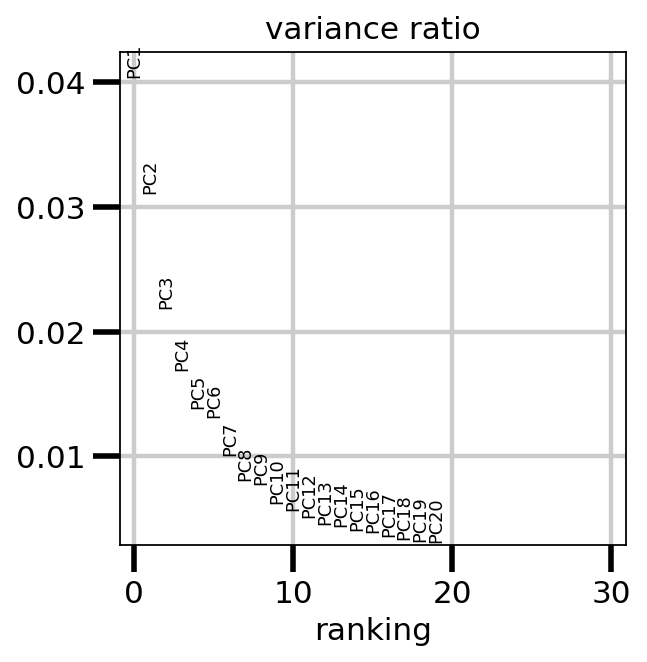

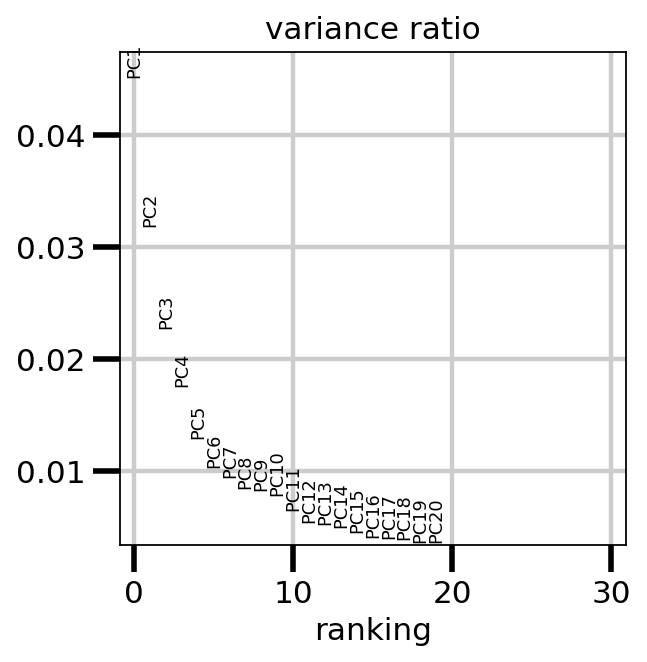

In [16]:
campari_cells = np.where(stim != 0)[0]
control_cells = np.where(stim == 0)[0]

print('Number of campari cells = ', len(campari_cells))
print('Number of control cells = ', len(control_cells))

adata_campari = adata[campari_cells,:]
adata_control = adata[control_cells,:]

### Dimentionality reduction examples using multiple techniques
### Select one number of componets, for example n = 15 and do louvain in the umap transformation 
# with that number of componets (we use the same number of components that was previously selected)
N_selected = NO_PCA
sc.pp.pca(adata_campari, n_comps=N_selected, use_highly_variable=True, svd_solver='arpack')
sc.pp.pca(adata_control, n_comps=N_selected, use_highly_variable=True, svd_solver='arpack')

rcParams['figure.figsize']=(4,4)
sc.pl.pca_variance_ratio(adata_campari)
sc.pl.pca_variance_ratio(adata_control)

In [17]:
sc.pp.neighbors(adata_campari)
sc.tl.tsne(adata_campari)
sc.tl.umap(adata_campari)

sc.pp.neighbors(adata_control)
sc.tl.tsne(adata_control)
sc.tl.umap(adata_control)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 20
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 20
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


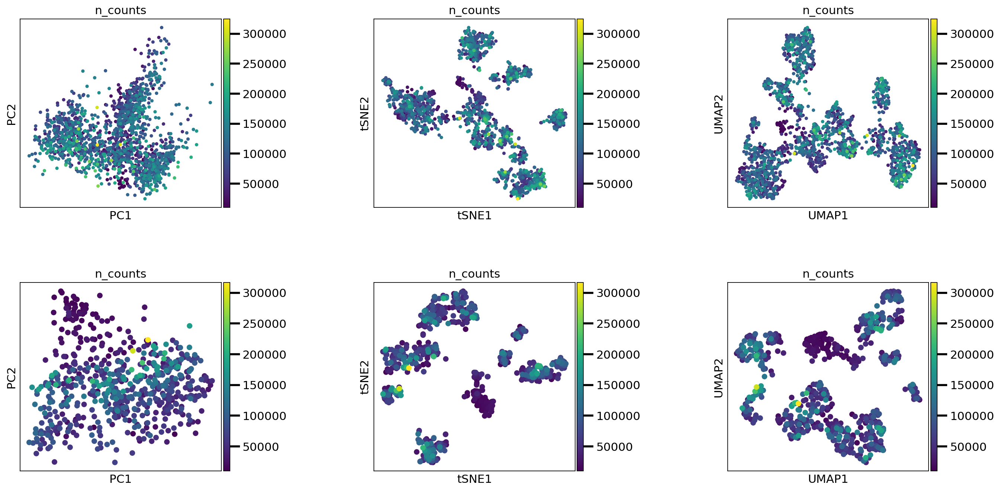

In [18]:
rcParams['figure.figsize']=(20,10)
fig_ind=np.arange(231, 237)
fig = plt.figure()
fig.subplots_adjust(hspace=0.4, wspace=0.6)

p10 = sc.pl.pca_scatter(adata_campari, color='n_counts', ax=fig.add_subplot(fig_ind[0]), show=False)
p11 = sc.pl.tsne(adata_campari, color='n_counts', ax=fig.add_subplot(fig_ind[1]), show=False)
p12 = sc.pl.umap(adata_campari, color='n_counts', ax=fig.add_subplot(fig_ind[2]), show=False)
p20 = sc.pl.pca_scatter(adata_control, color='n_counts', ax=fig.add_subplot(fig_ind[3]), show=False)
p21 = sc.pl.tsne(adata_control, color='n_counts', ax=fig.add_subplot(fig_ind[4]), show=False)
p22 = sc.pl.umap(adata_control, color='n_counts', ax=fig.add_subplot(fig_ind[5]), show=False)

plt.show()

In [19]:
rcParams['figure.figsize']=(4,4)

labels=['Control','Pinch','New_stroke','Ballon','AG','AD','Heating','Mock','Old_stroke','Anal_pinch','Mock_w_poop','Vaginal_distension','Tomatoe','Poop', 
        'Bladder','CRD','AD+CFA','AGB+CFA','Heating+CFA','Tail Brush','TRPM8 td tomato',
        'AD + Pulse', 'AGB-CFA 1 W','AD-CFA 1W','HP','Penis','Clitoris Vibration','Max Cells',
        'Tracing Ano Genital Skin injection','Crazy Mock','Tracing Anal injection', 'Tracing Vagina']
# need to add more colors for all in all in one plot
# color = ['gainsboro','green','darkorange','purple','magenta','cyan','red','orange','yellow','brown','orange','blue','violet','k','olive','pink','darkred','peru','darkcyan','blueviolet','lime']


In [20]:


### transform adata sparse matrix to scipy
x = adata_umap.X
### create exportable arrays with information about stimuli, fluorecence, and louvain transformations
stim = np.zeros((x.shape[0],))
plate_numbers = np.zeros((x.shape[0],))
red = np.zeros((x.shape[0],))
green = np.zeros((x.shape[0],))
for i in range(x.shape[0]):
    stim[i] = adata_umap.obs['stimulus'][i]
    plate_numbers[i] = adata_umap.obs['plate_number'][i]
    red[i] = adata_umap.obs['red'][i]
    green[i] = adata_umap.obs['green'][i]


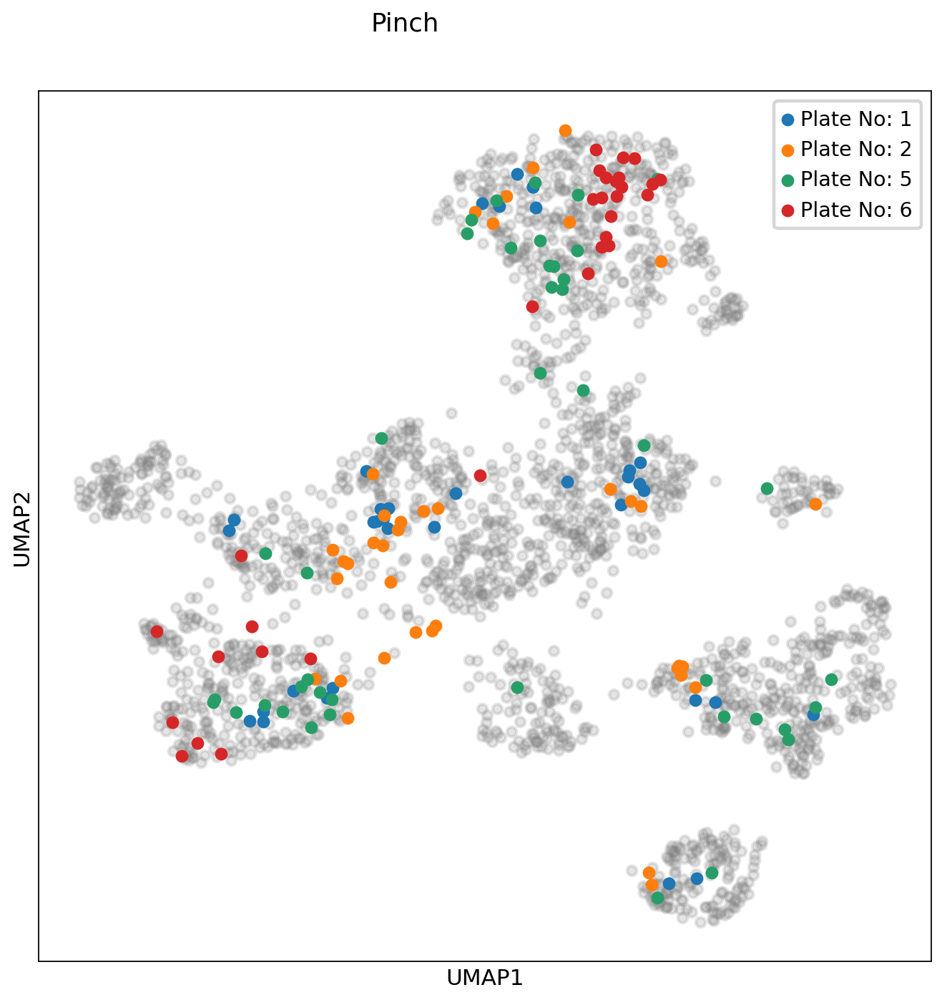

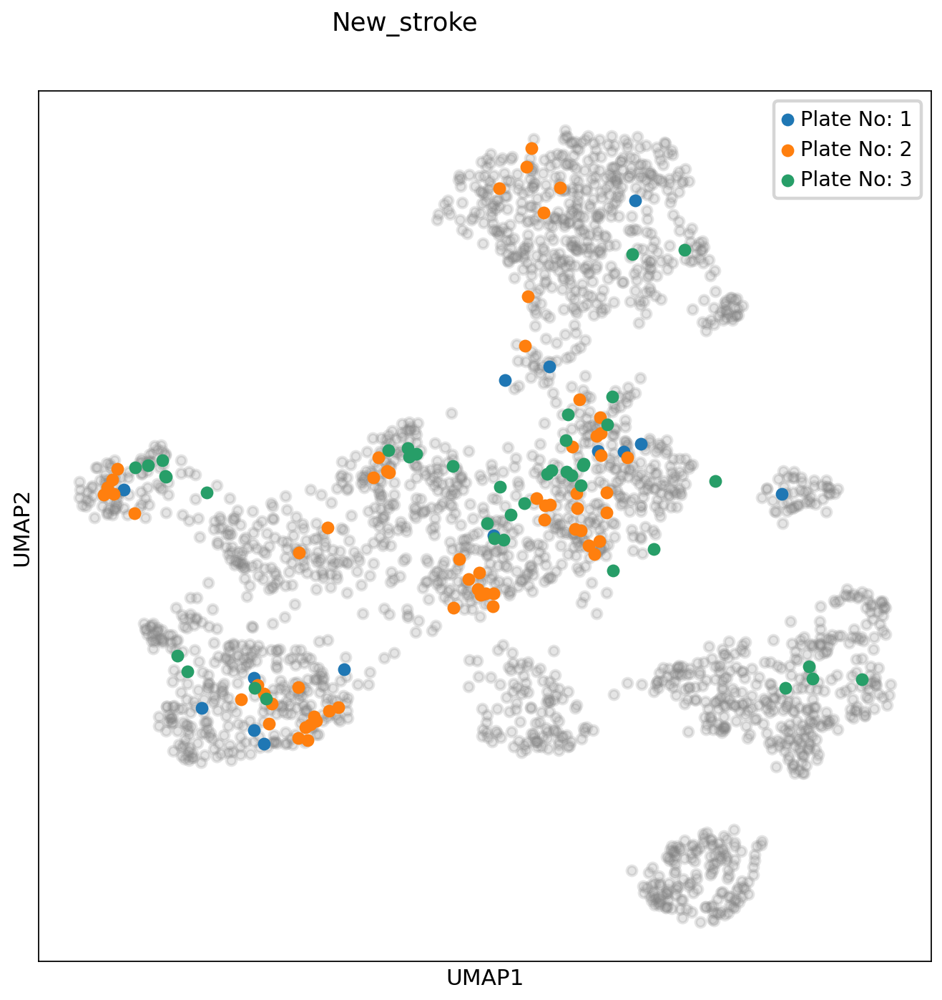

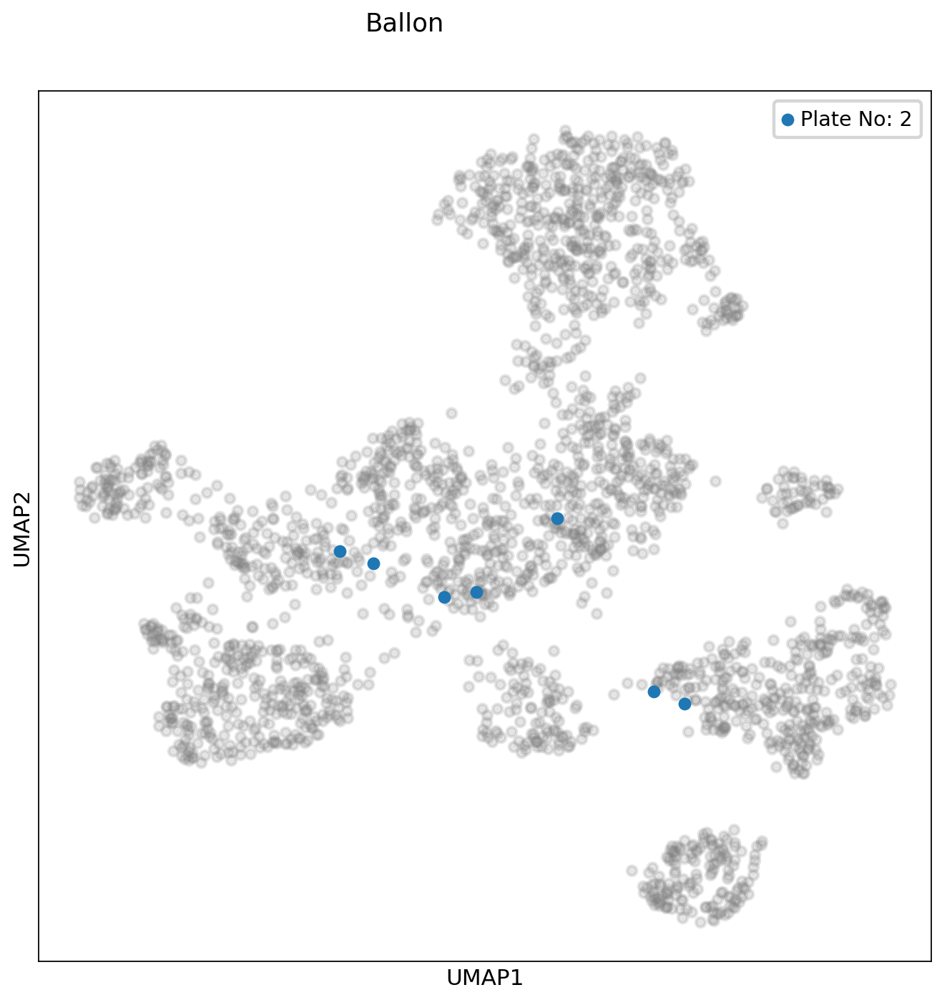

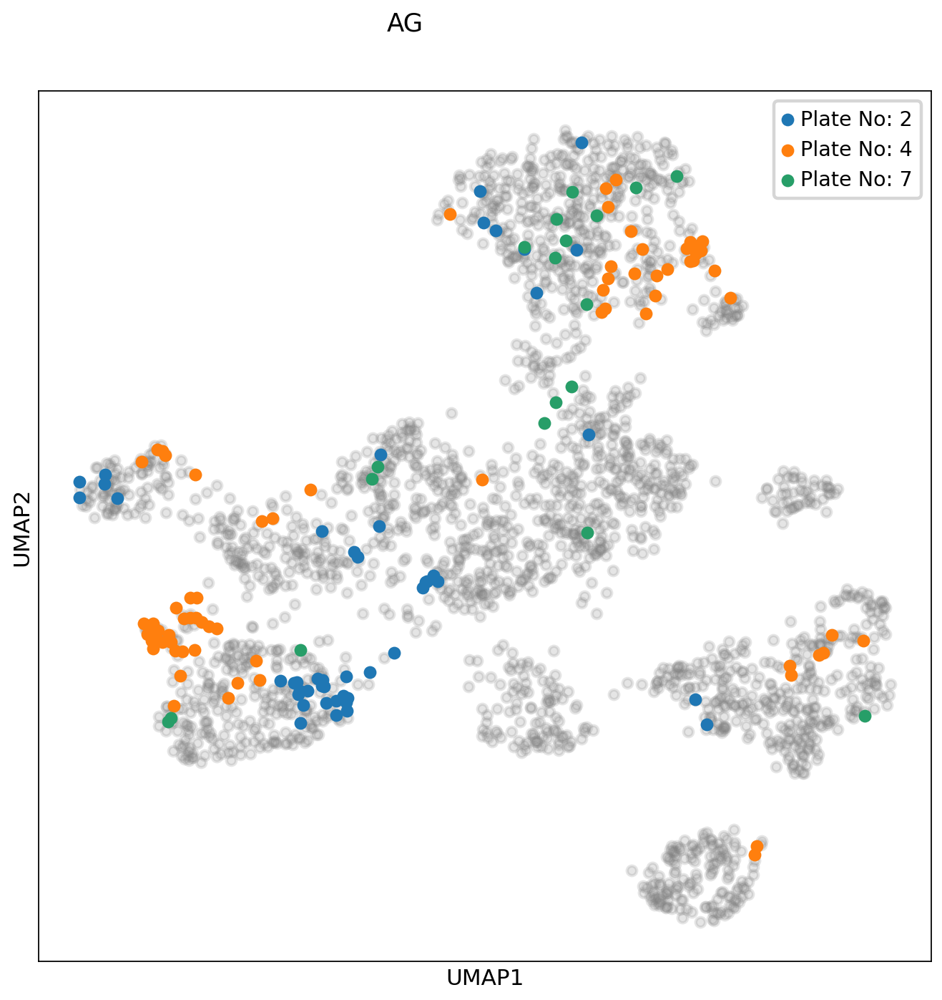

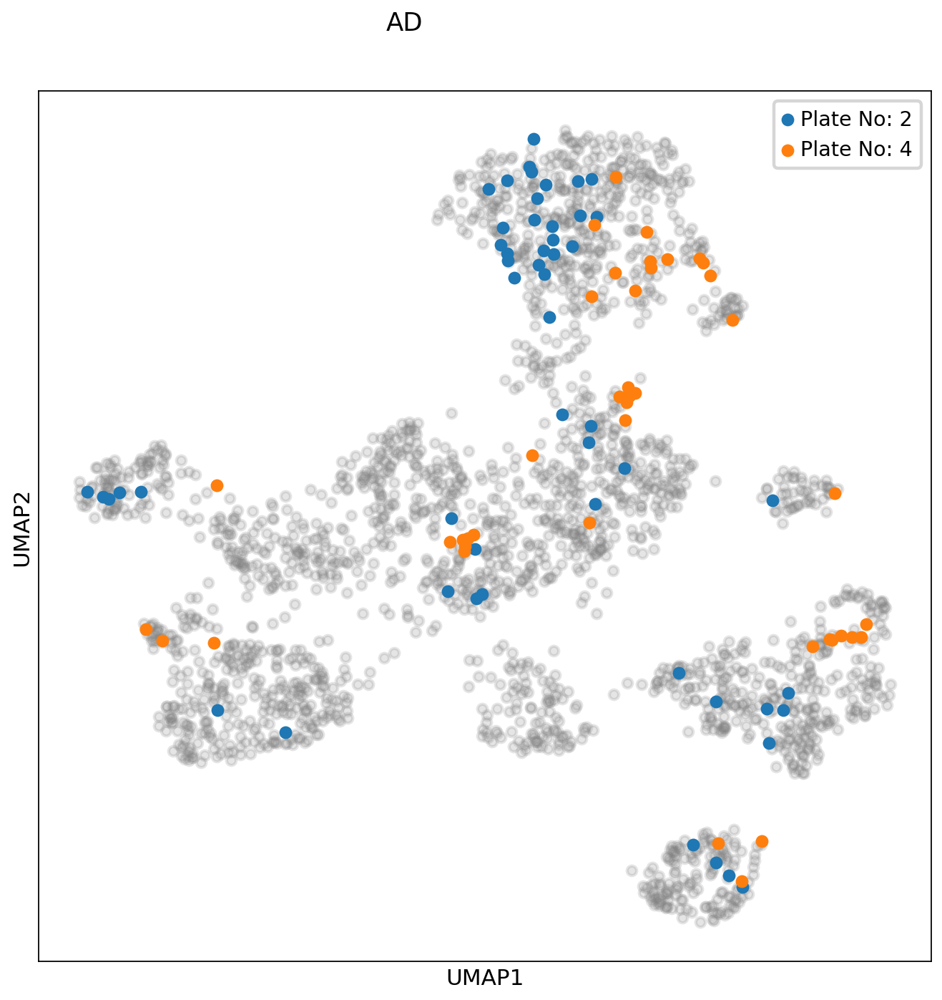

...

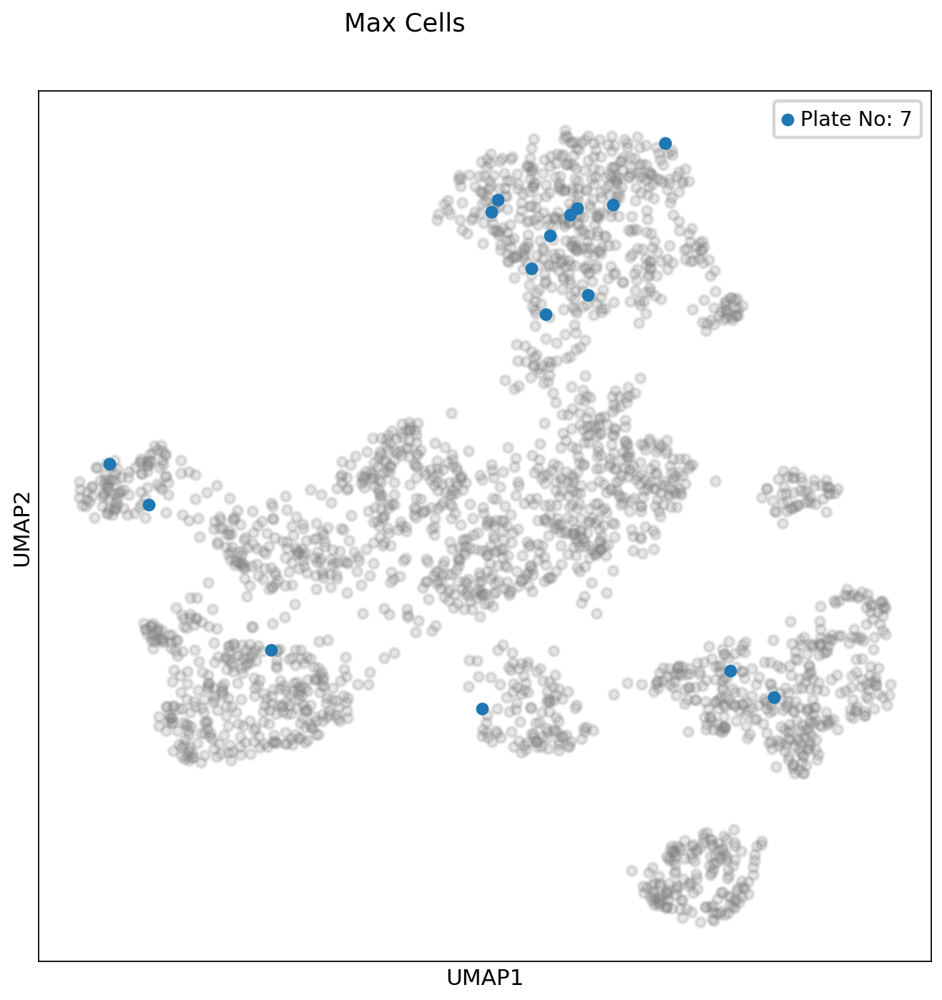

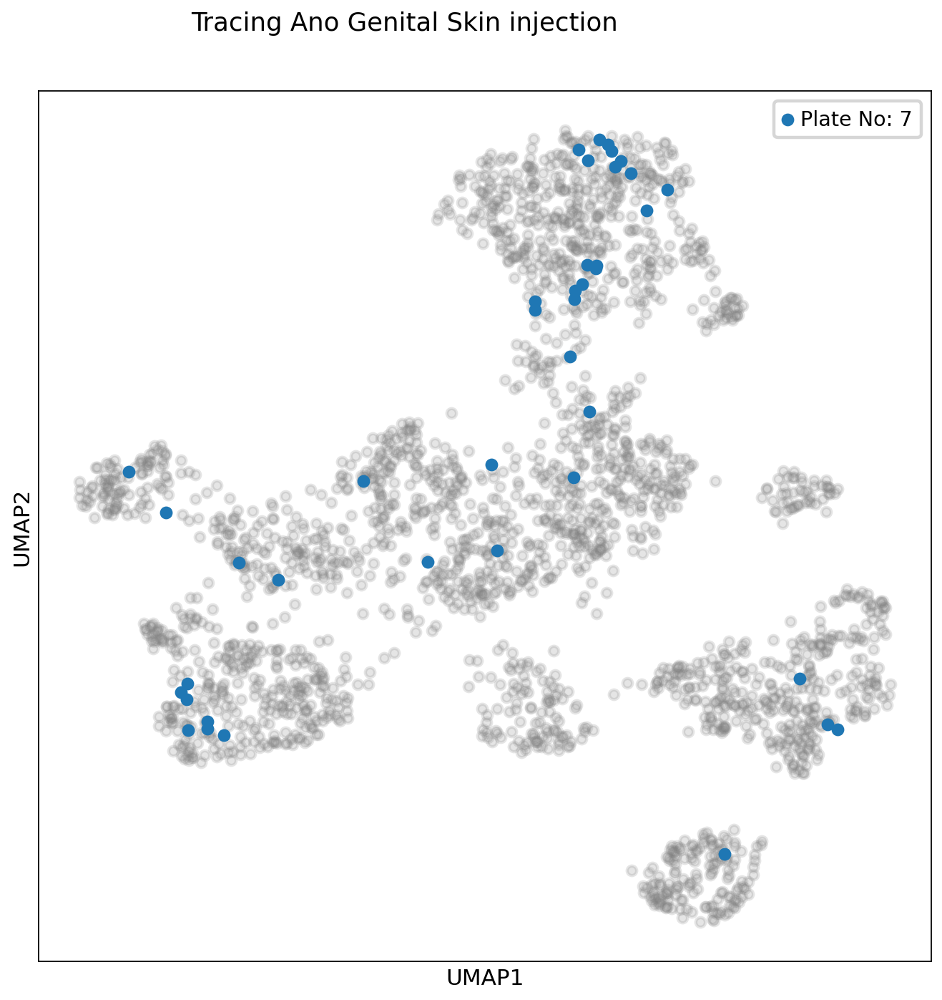

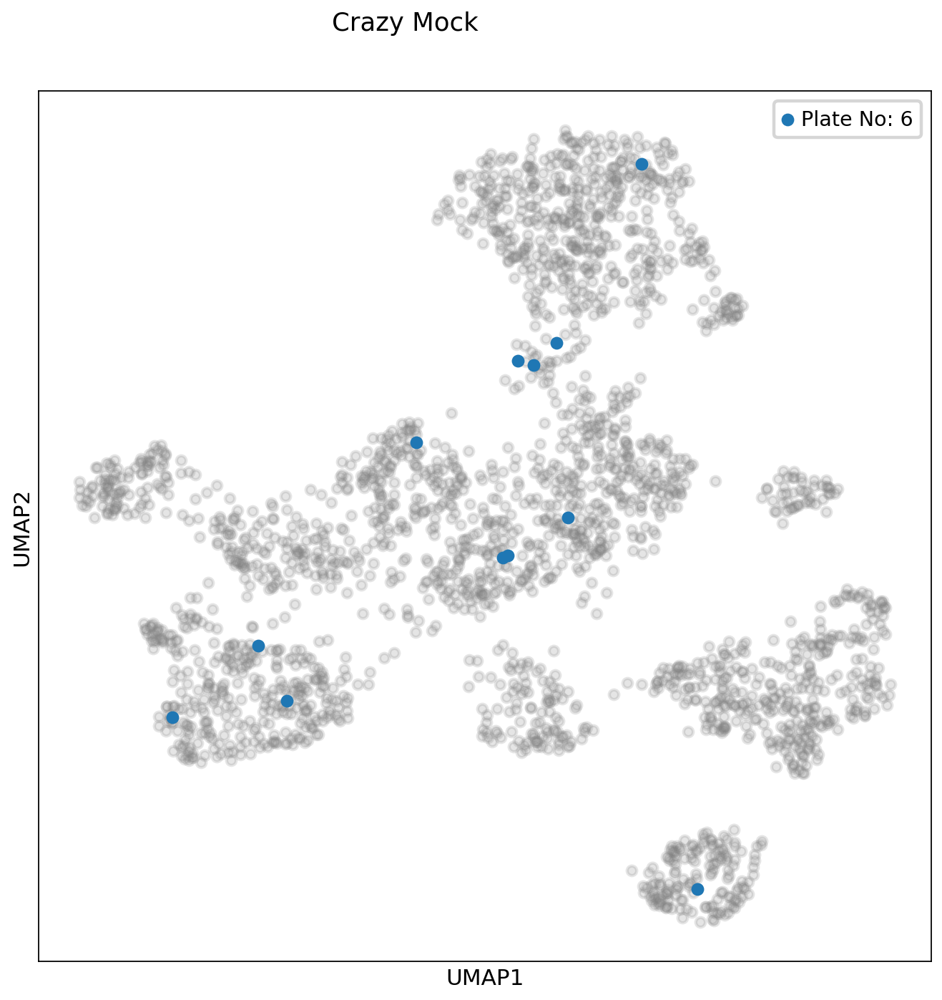

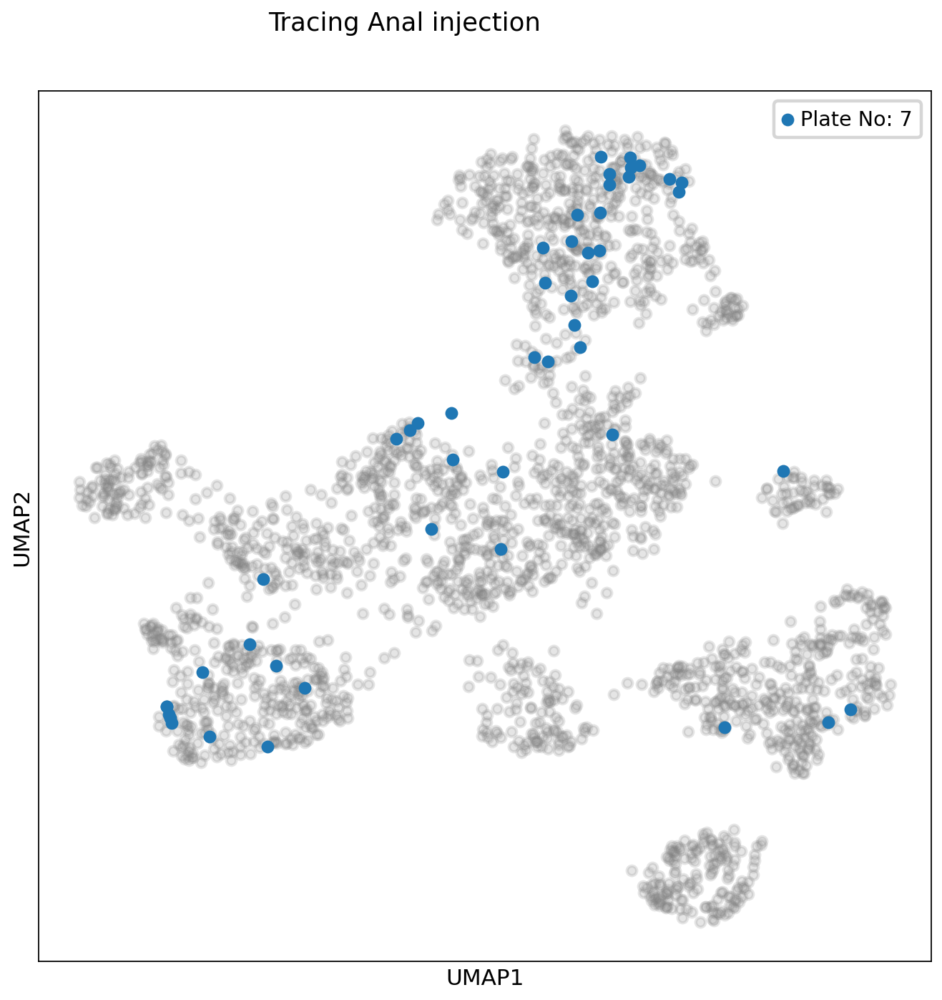

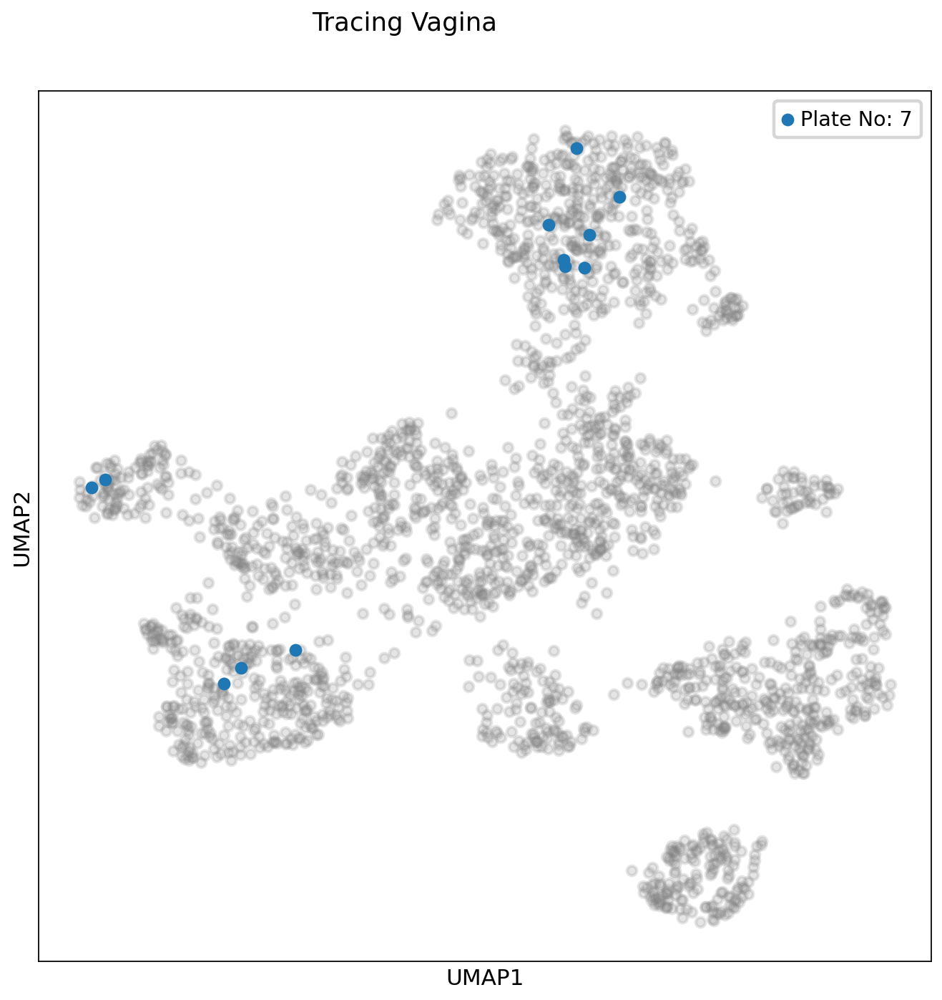

In [22]:
# show each stimulus separately, distinguish between each sample(plate)
unique_wells = list(set(plate_numbers))
for i in range(1,len(labels)):
    figure, axes = plt.subplots()
    axes.scatter(adata_umap.obsm['X_umap'][:,0],adata_umap.obsm['X_umap'][:,1],c='gray',alpha=0.2)
    # unique_wells = list(set(plate_numbers))
    stim_index = np.where(stim == i)[0]
    for well in unique_wells: # show different wells differently
        well_index = np.where(plate_numbers == well)[0]
        # select only common indexes
        index = list(set(stim_index).intersection(well_index))
        if len(index) > 0:
            # print(f"{labels[i]}: well: {well}")
            axes.scatter(adata_umap.obsm['X_umap'][index,0],adata_umap.obsm['X_umap'][index,1],label="Plate No: "+str(int(well)))
    axes.grid(False)
    axes.legend()
    figure.set_size_inches([10,10])
    figure.suptitle(labels[i], fontsize=16)
    # Hide X and Y axes tick marks
    axes.set_xticks([])
    axes.set_yticks([])
    axes.set_xlabel('UMAP1')
    axes.set_ylabel('UMAP2')
    figure.savefig(os.path.join(figure_path, 'stimulus_'+labels[i]+'.png'))

In [17]:
# ### plotting all stimulus together

# figure, axes = plt.subplots()
# #red_norm = (red - np.min(red)) / (np.max(red) - np.min(red))
# for i in range(len(labels)):
#     # print(labels[i])
#     # print(red[index])
#     index = np.where(stim == i)[0]
#     red_norm = (red[index] - np.min(red[index])) / (np.max(red[index]) - np.min(red[index]) + sys.float_info.epsilon) # ?
#     red_norm = (red_norm + 0.1)/1.1
#     axes.scatter(adata_umap.obsm['X_umap'][index,0],adata_umap.obsm['X_umap'][index,1], s = 50, c = color[i], alpha = red_norm)
# axes.grid(visible = 'None')
# #axes.set_xlim([0,19])
# #axes.set_ylim([0,19])
# axes.set_xlabel('UMAP1', fontsize = 20)
# axes.set_ylabel('UMAP2', fontsize = 20)
# axes.tick_params(axis='both', which='major', labelsize=12)
# axes.tick_params(axis='both', which='minor', labelsize=12)
# axes.grid(False)

# axes.legend(labels, fontsize = 12)
# #sc.pl.umap(adata, color = 'stimulus', color_map = 'Set1', save = 'stimulus'+ '.png', size = 180)
# figure.set_size_inches([10,10])
# # figure.savefig(os.path.join(figure_path, 'stimulus.png'))

(807, 16000)


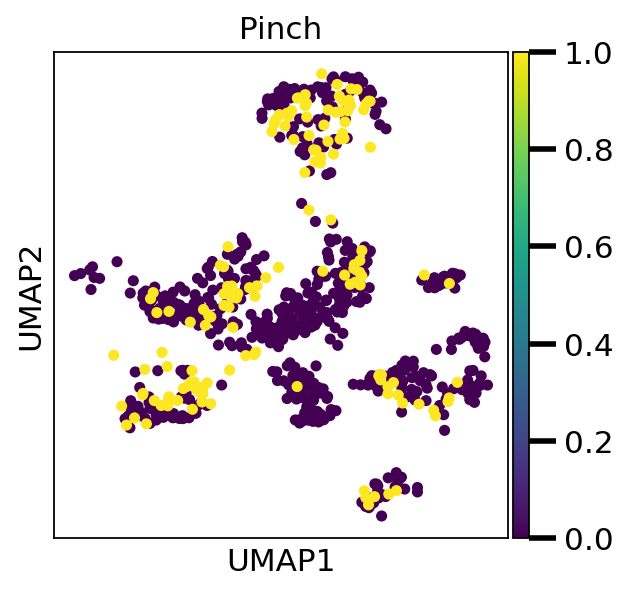

(779, 16000)


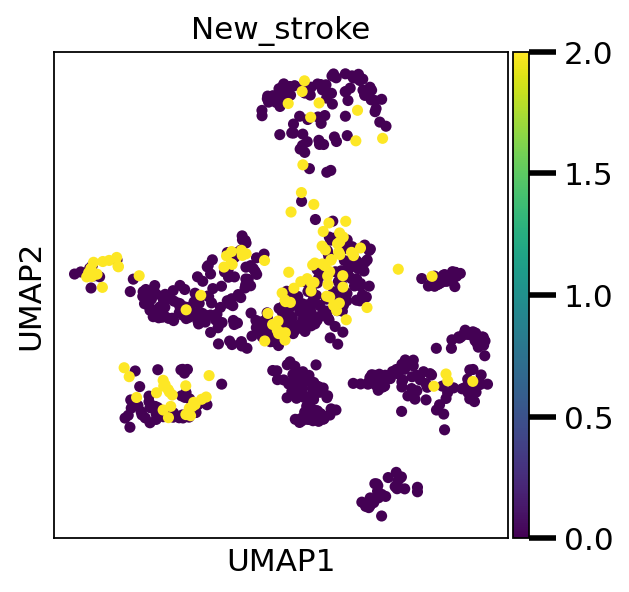

(668, 16000)


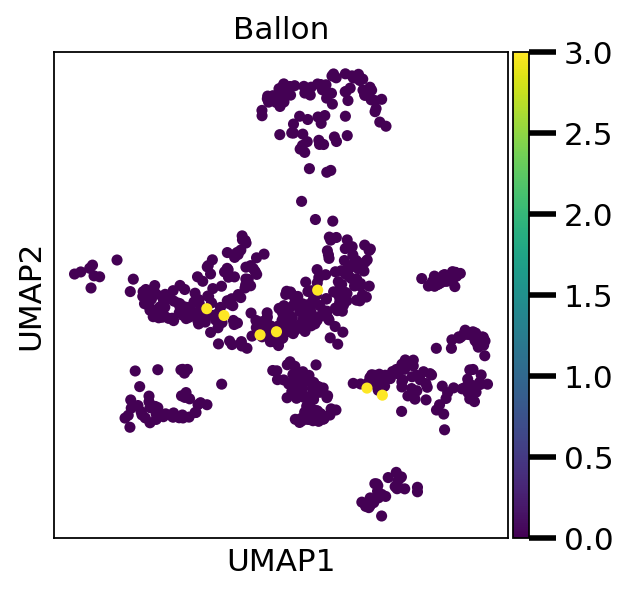

(802, 16000)


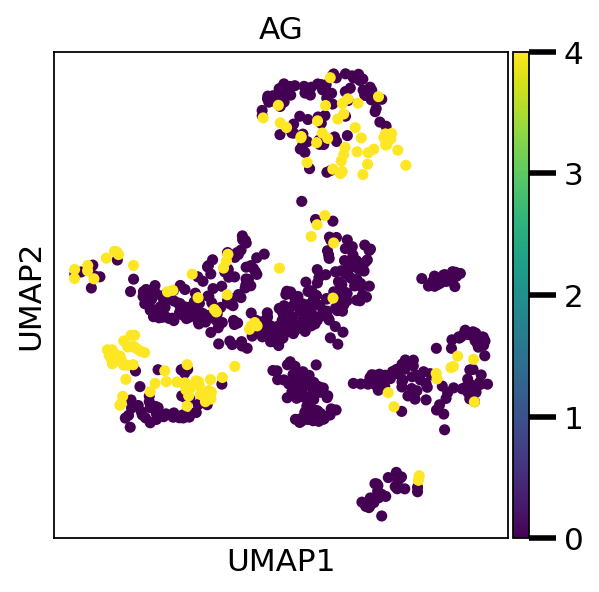

(758, 16000)


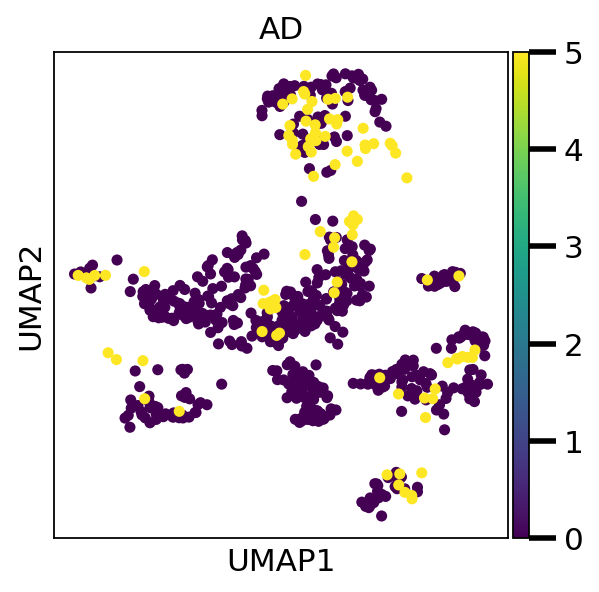

(751, 16000)


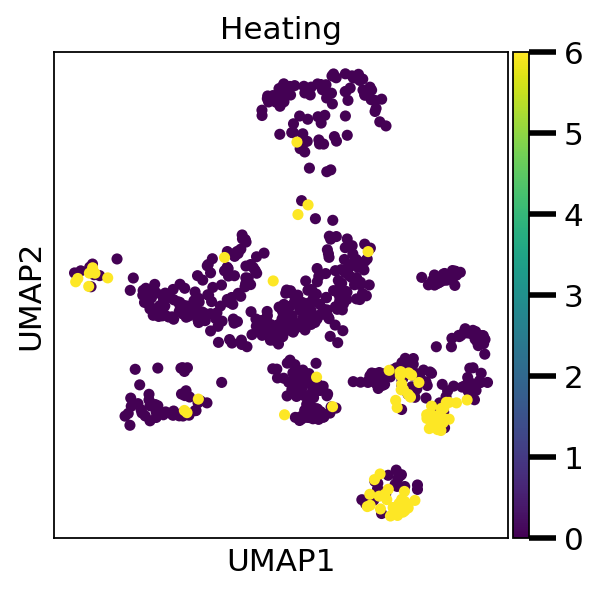

(675, 16000)


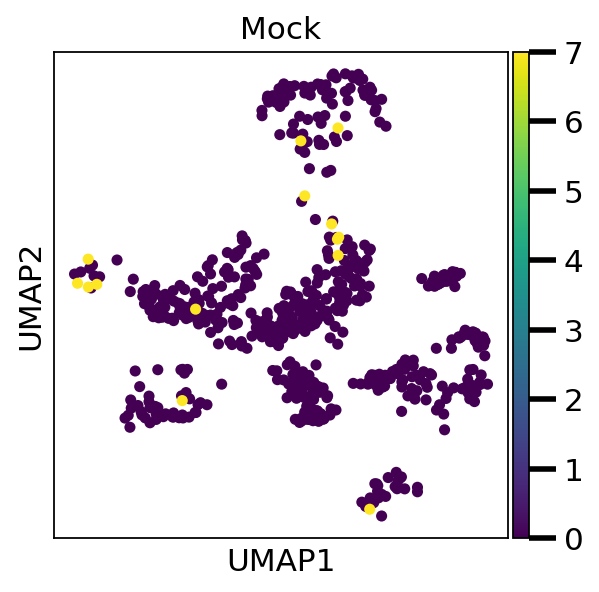

(713, 16000)


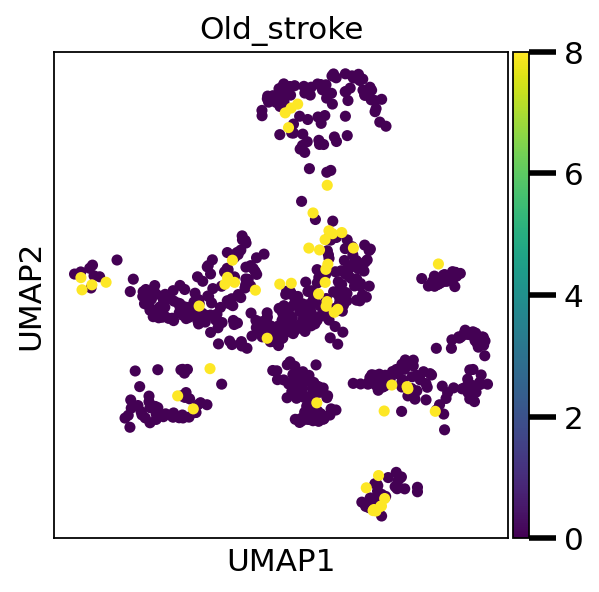

(691, 16000)


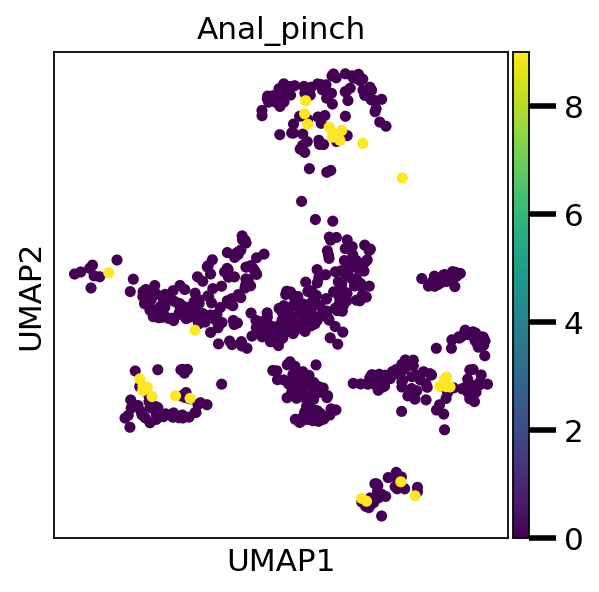

(665, 16000)


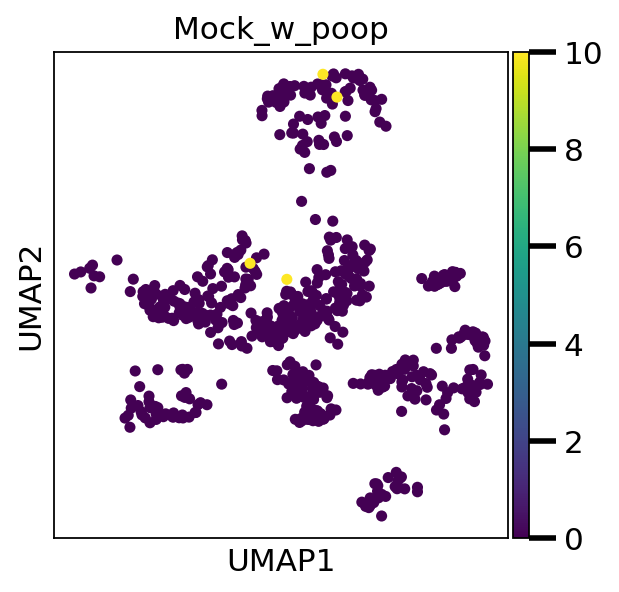

(748, 16000)


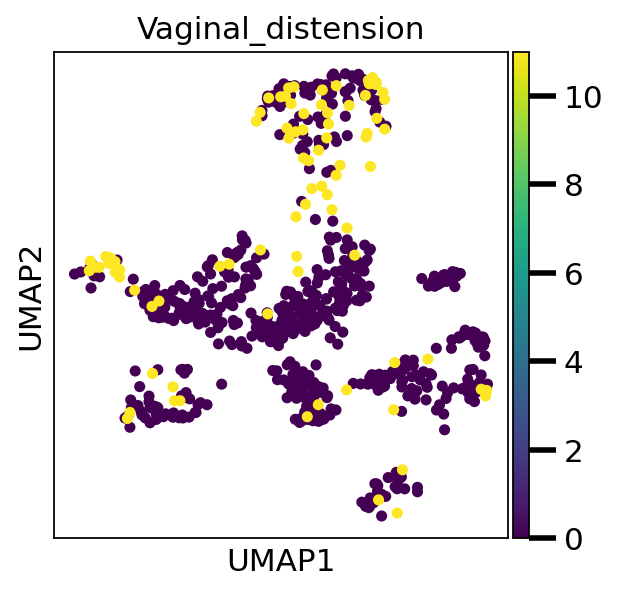

(682, 16000)


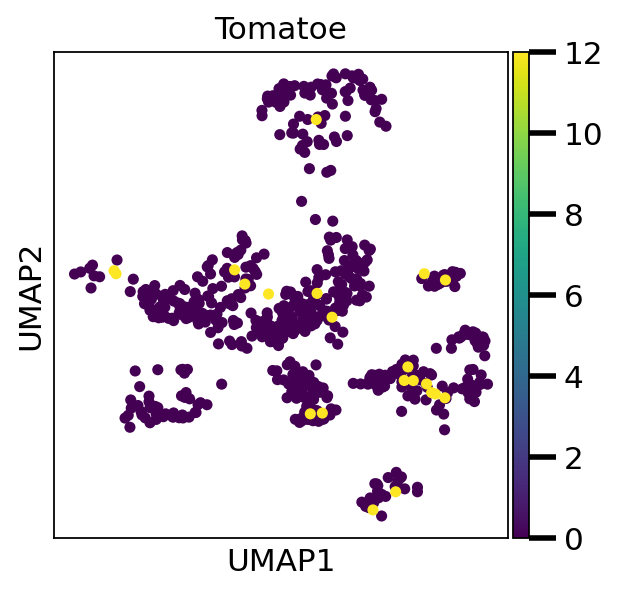

(662, 16000)


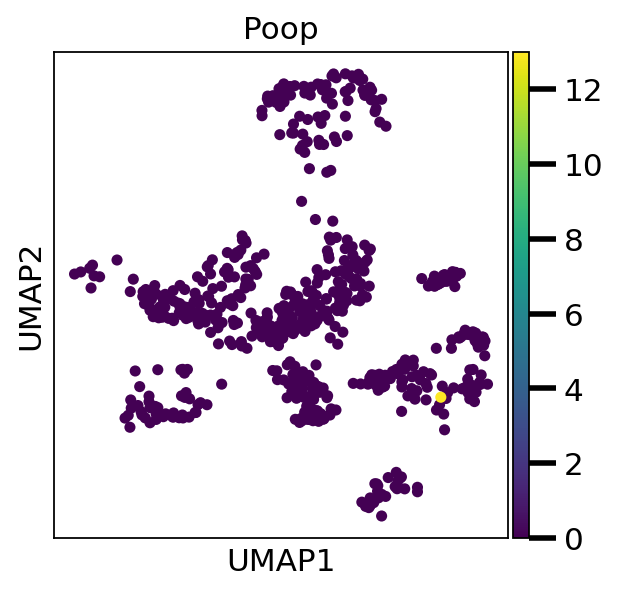

(670, 16000)


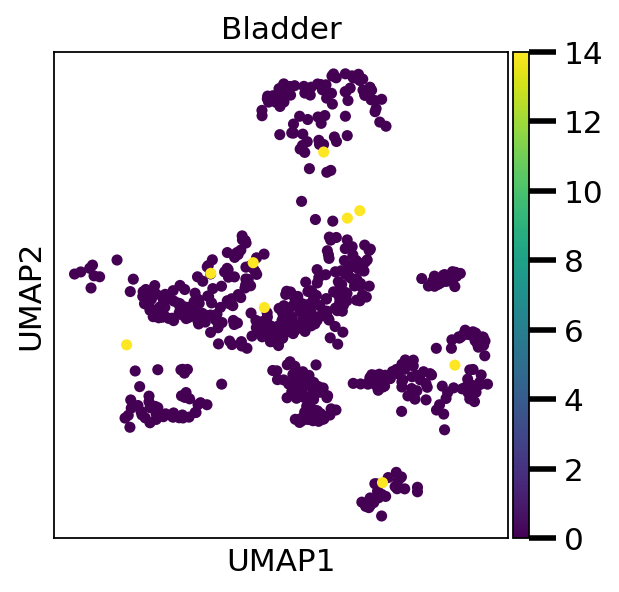

(664, 16000)


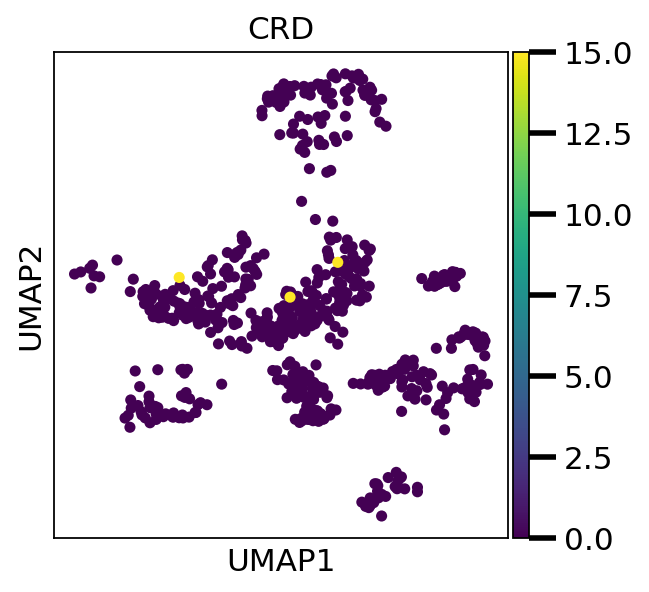

(756, 16000)


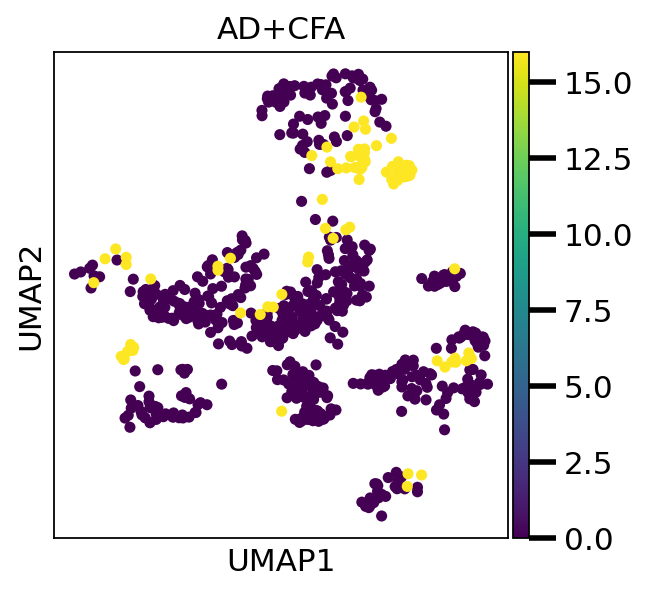

(779, 16000)


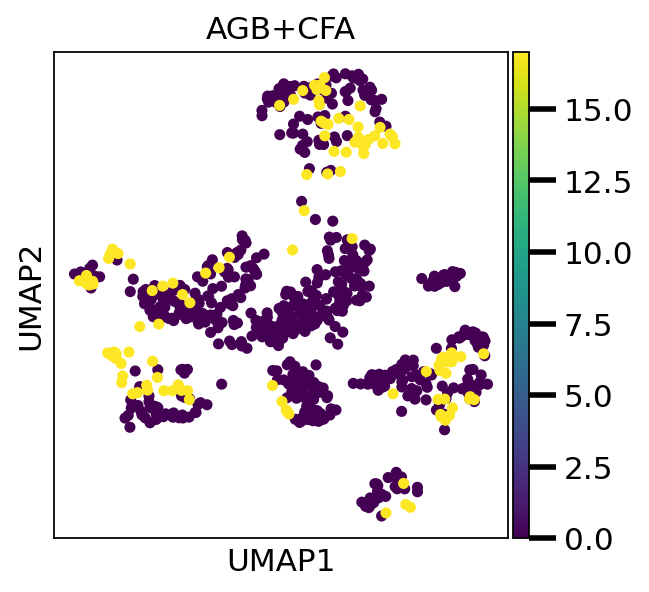

(744, 16000)


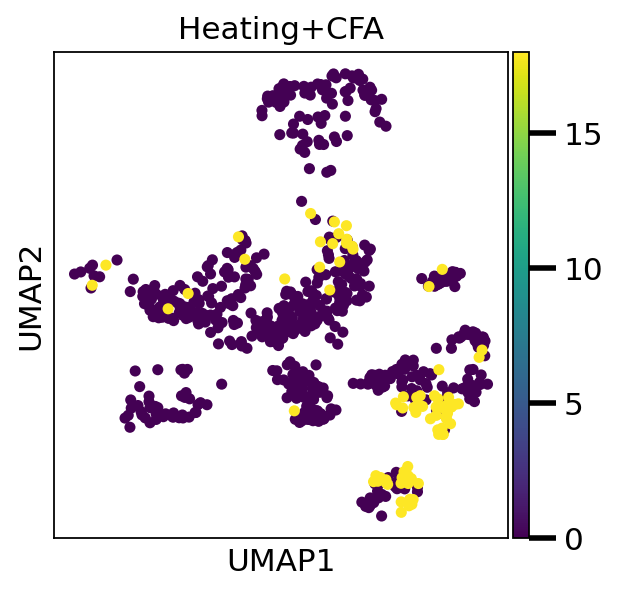

(709, 16000)


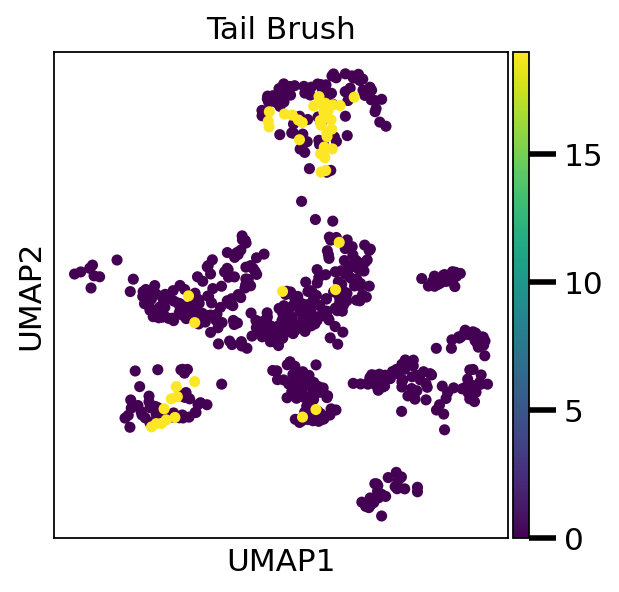

(741, 16000)


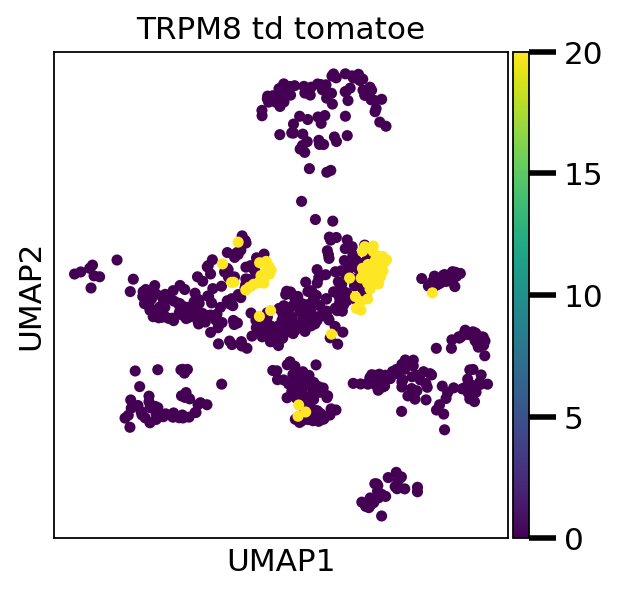

(713, 16000)


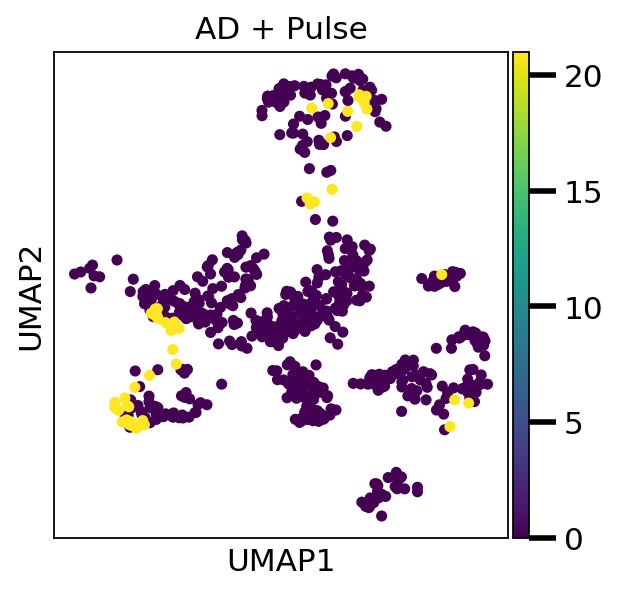

(705, 16000)


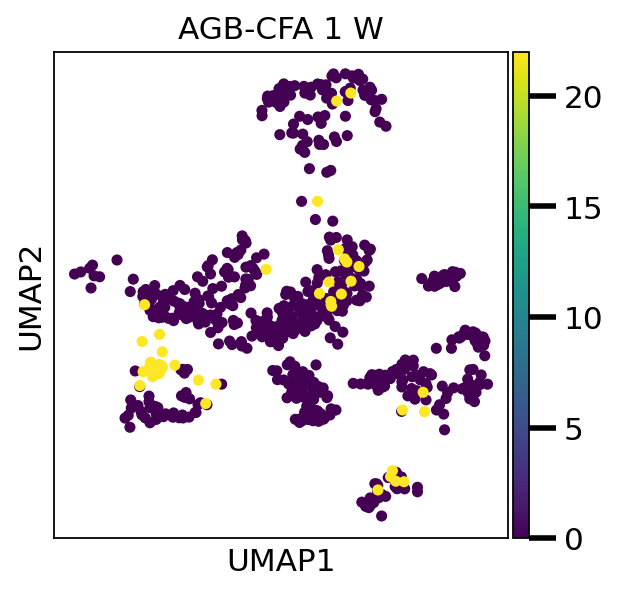

(703, 16000)


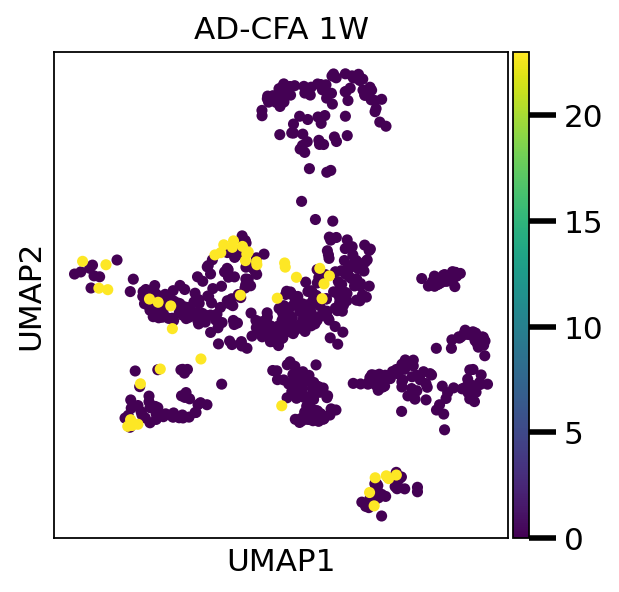

(775, 16000)


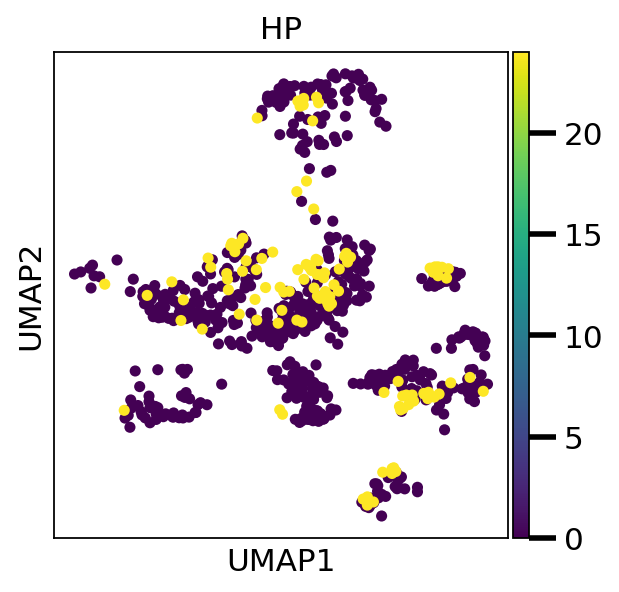

(748, 16000)


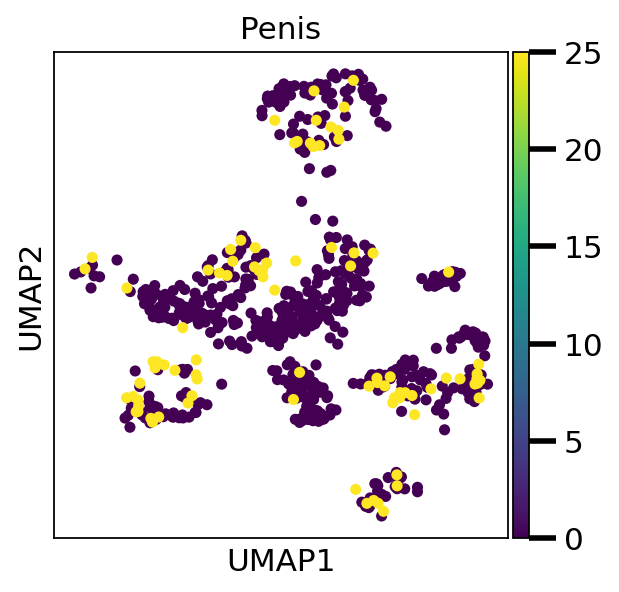

(711, 16000)


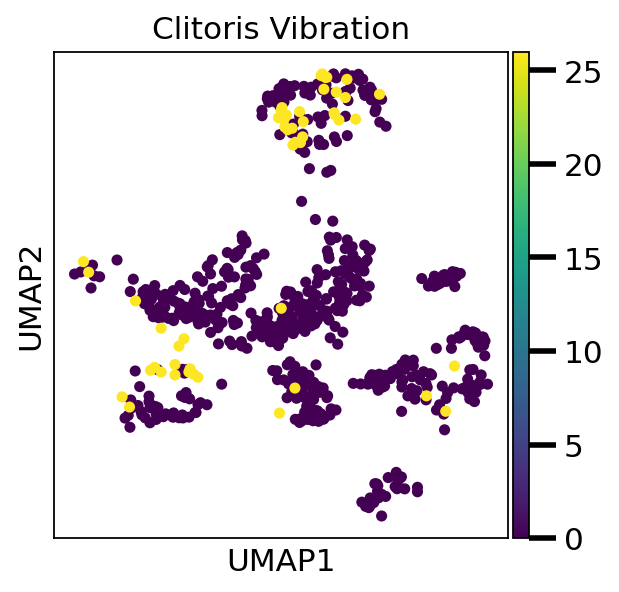

(677, 16000)


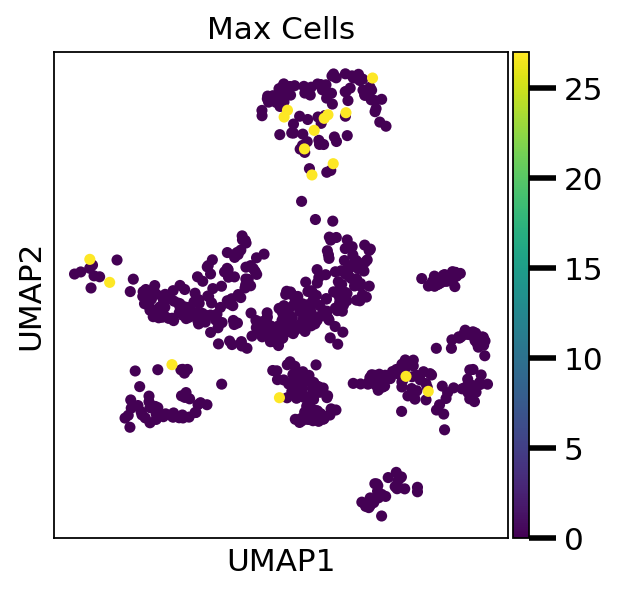

(701, 16000)


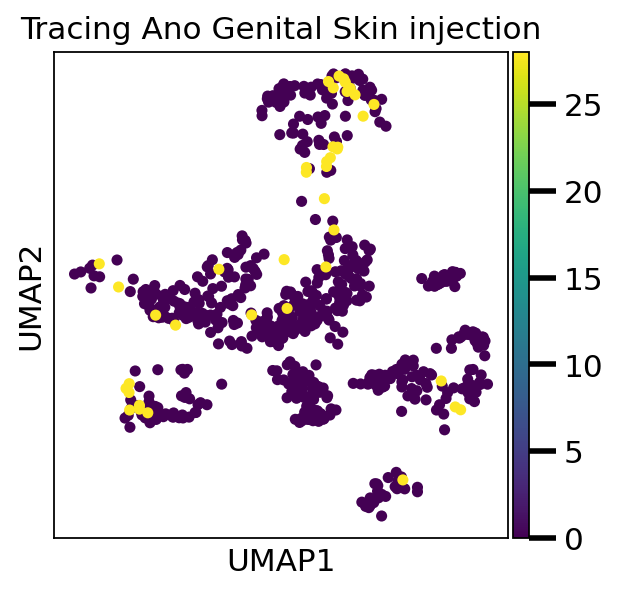

(673, 16000)


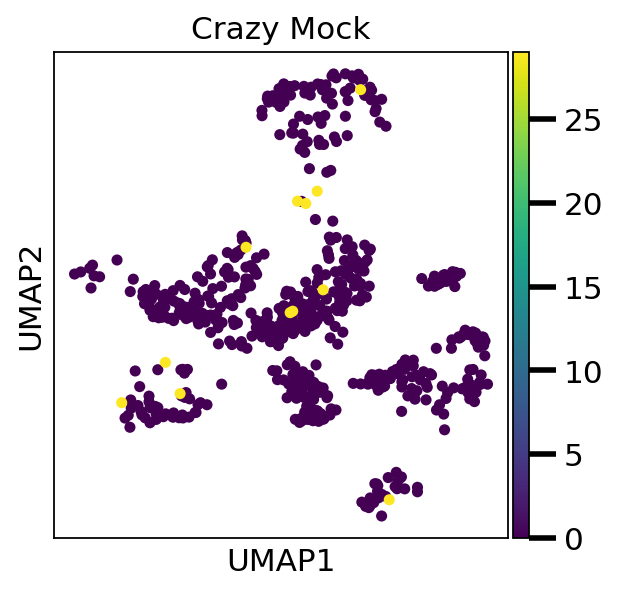

(709, 16000)


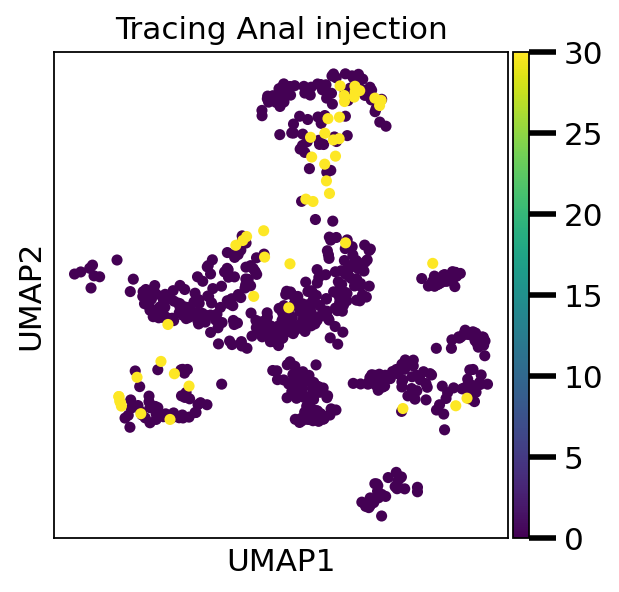

(673, 16000)


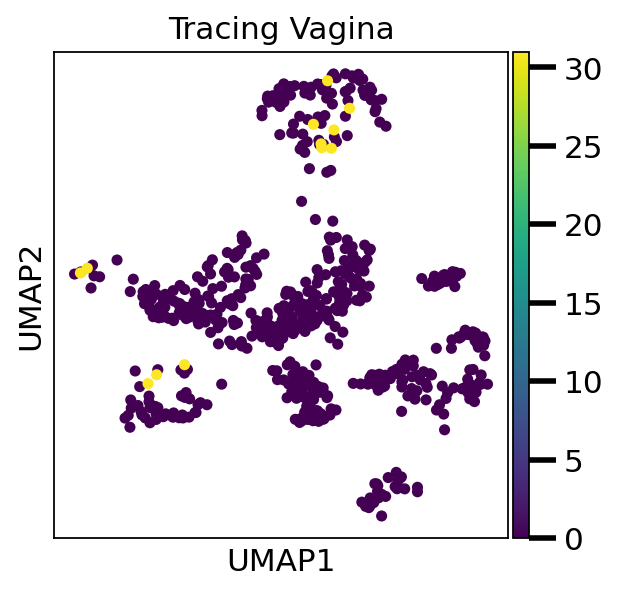

In [23]:
### plotting stimuli individualy

rcParams['figure.figsize']=(4,4)

for i in range(1,len(labels)):
    index = np.logical_or(adata_umap.obs['stimulus'] == i,adata_umap.obs['stimulus'] == 0)
    aux_adata = adata_umap[index,:]
    print(aux_adata.shape)
    sc.pl.umap(aux_adata, color = 'stimulus', title=labels[i], color_map = 'viridis', save = '_stimulus_' + labels[i]+ '.png', size = 100)
    # sc.pl.umap(adata_umap, color = 'stimulus', title=labels[i], color_map = 'viridis', save = '_stimulus_' + labels[i]+ '.png', size = 100)

In [19]:
# ### plotting subsequent stimulus to add individually in a gif (only for selected stimuli)
# stimulus_list = [0,4,5,2,1,9,6,11,12]
# new_labels=['Control','AG','AD','new_stroke','pinch','anal_pinch','heating','vaginal_distension','non']
# count = 0
# for i in stimulus_list:
#     print(i)
#     figure, axes = plt.subplots()
#     sublist = stimulus_list[0:count]
#     print(sublist)
#     for j in sublist:
#         index = np.where(stim == j)[0]
#         red_norm = (red[index] - np.min(red[index])) / (np.max(red[index]) - np.min(red[index]) + sys.float_info.epsilon)
#         red_norm = (red_norm + 0.1)/1.1
#         axes.scatter(adata_umap.obsm['X_umap'][index,0],adata_umap.obsm['X_umap'][index,1], s = 10, c = color[j],alpha = red_norm)

#     axes.grid(visible = 'None')
#     #axes.set_xlim([0,22])
#     #axes.set_ylim([0,22])
#     axes.set_xlabel('UMAP1', fontsize = 20)
#     axes.set_ylabel('UMAP2', fontsize = 20)
#     axes.tick_params(axis='both', which='major', labelsize=12)
#     axes.tick_params(axis='both', which='minor', labelsize=12)
#     axes.grid(False)
#     axes.legend(new_labels, fontsize = 12)
#     figure.set_size_inches([7,7])
#     figure.savefig(os.path.join(figure_path, 'cum_stimulus'+ str(count) +'.png'))

#     count = count +1 

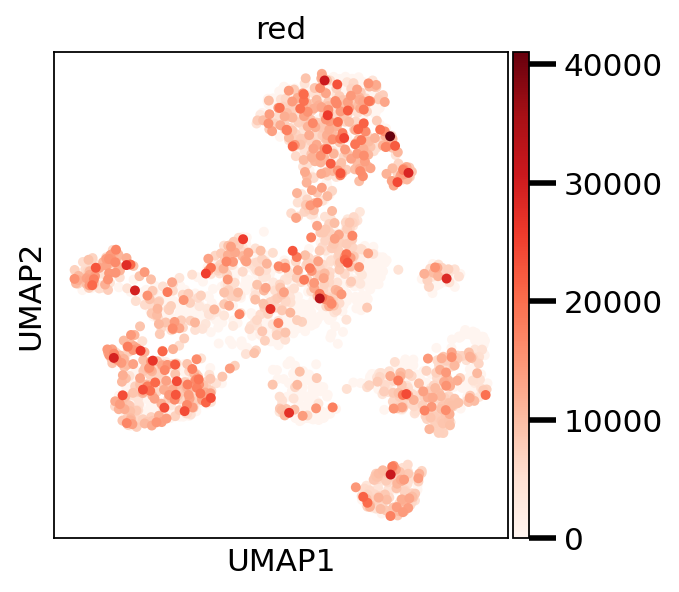

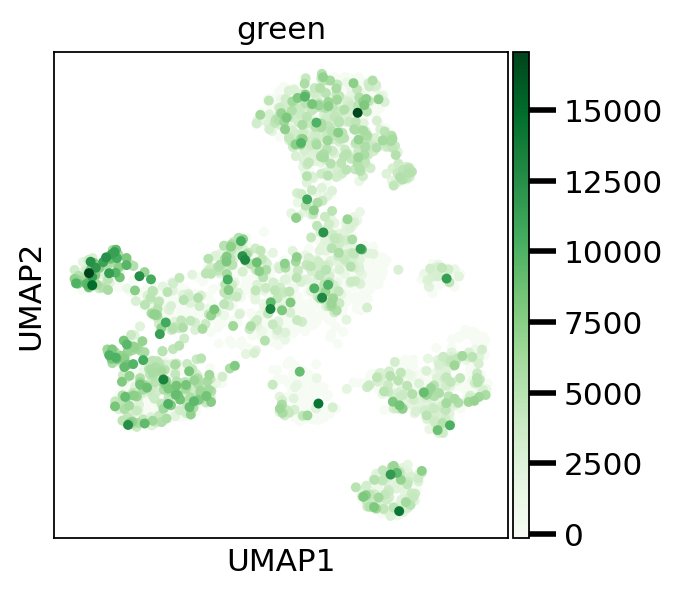

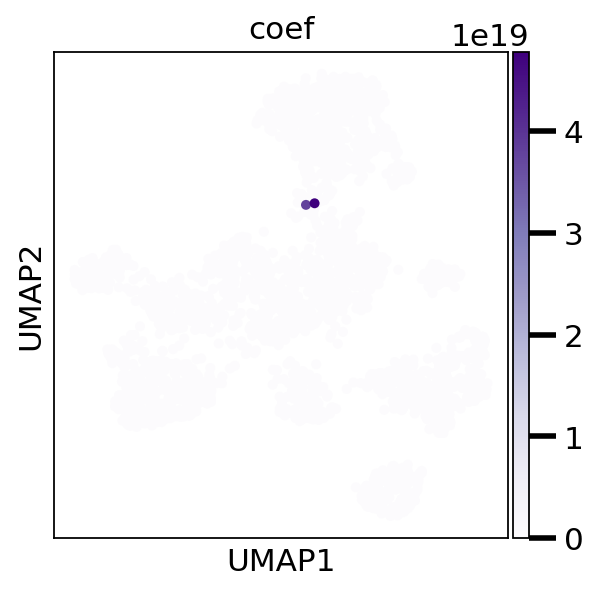

In [24]:
### plotting fluorecence levels 

sc.pl.umap(adata_umap, color='red', color_map = 'Reds', save = '_fluorecence_red_f' + '.png', size = 80)
sc.pl.umap(adata_umap, color='green', color_map = 'Greens', save = '_fluorecence_green_f' + '.png', size = 80)
adata_umap.obs['coef'] = adata_umap.obs['red']/(adata_umap.obs['green'] + sys.float_info.epsilon)
sc.pl.umap(adata_umap, color='coef', color_map = 'Purples', save = '_fluorecence_coef_f' + '.png', size = 80)

(807, 16000)


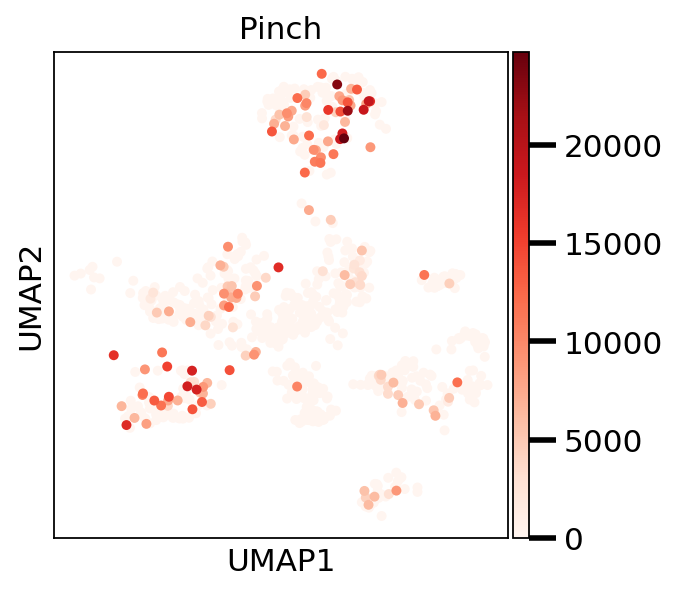

(779, 16000)


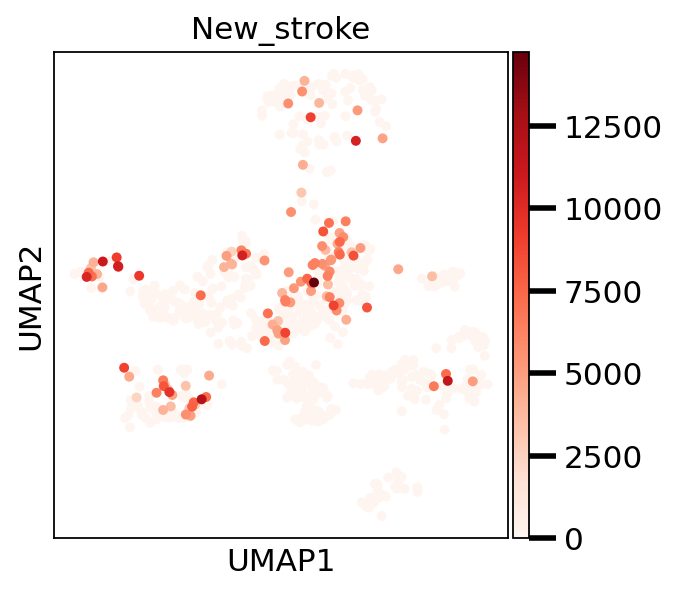

(668, 16000)


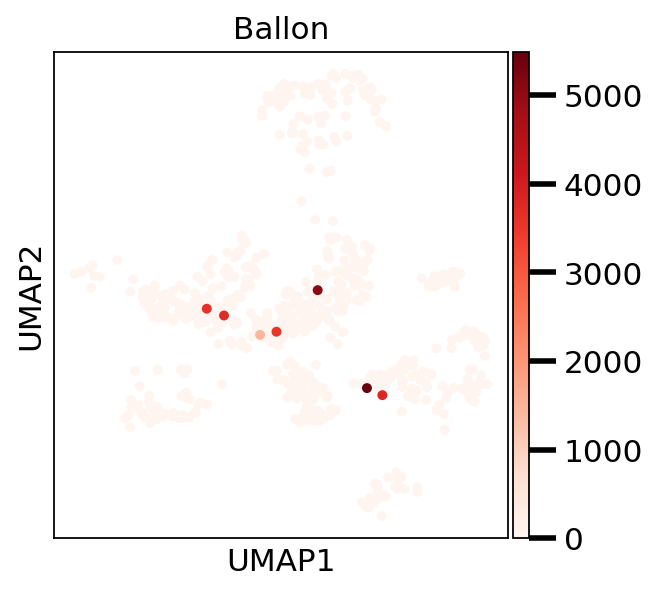

(802, 16000)


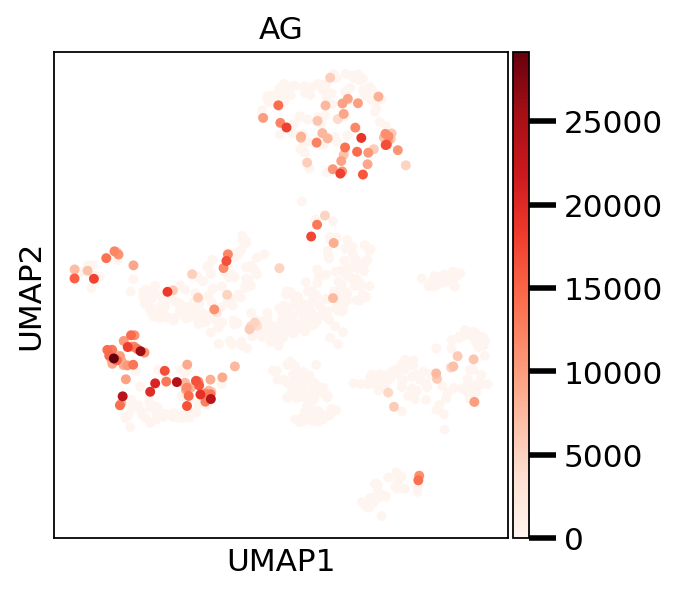

(758, 16000)


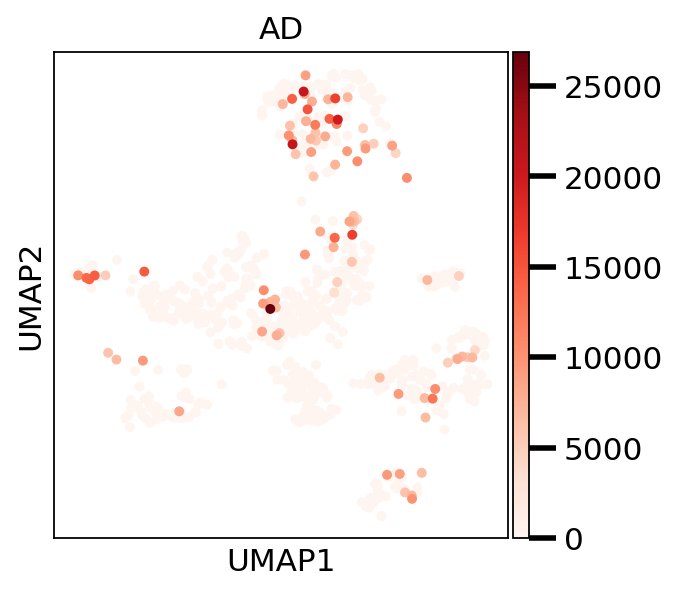

(751, 16000)


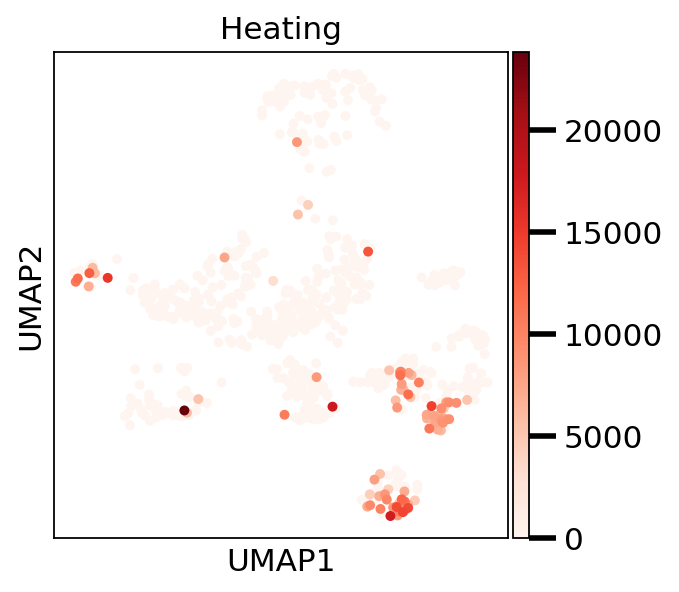

(675, 16000)


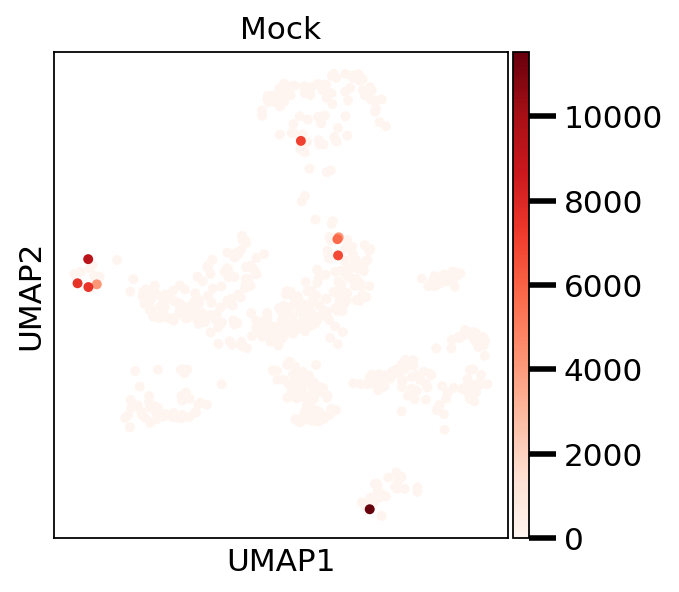

(713, 16000)


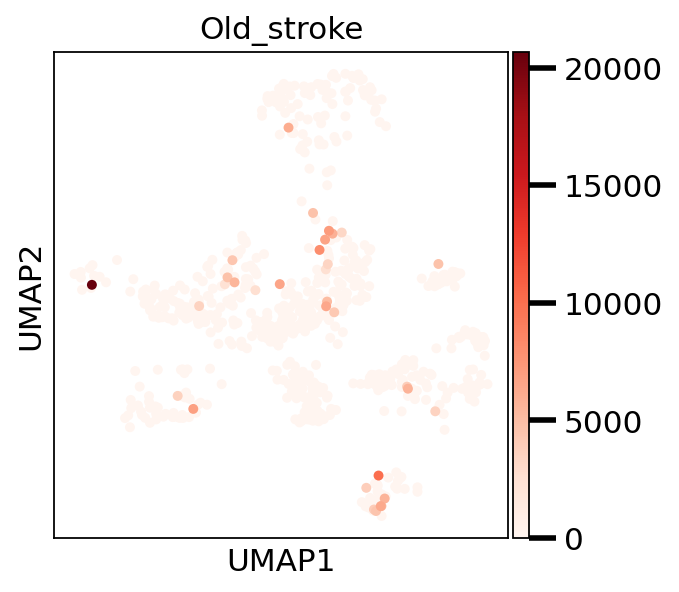

(691, 16000)


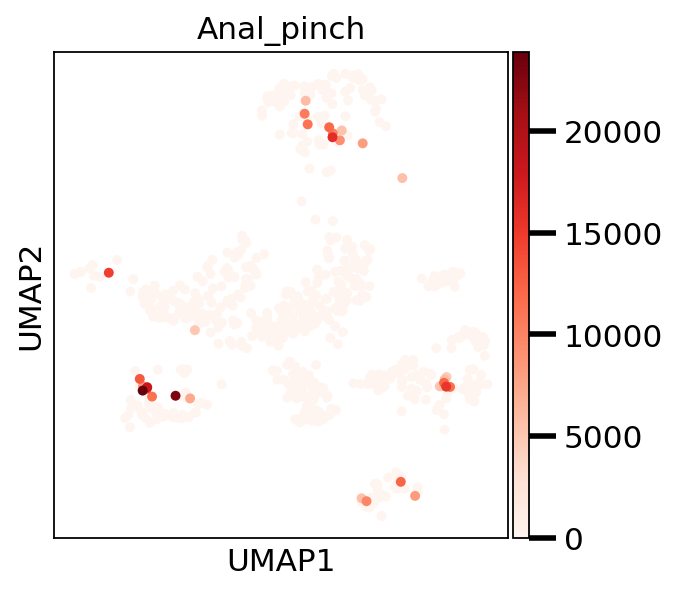

(665, 16000)


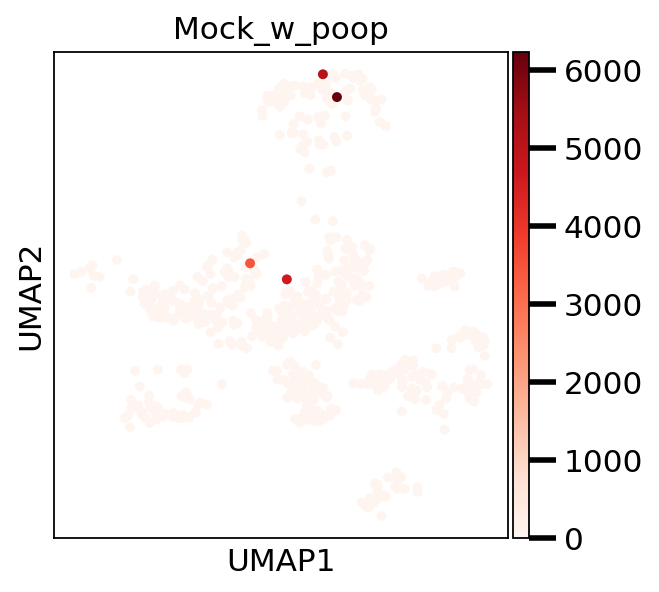

(748, 16000)


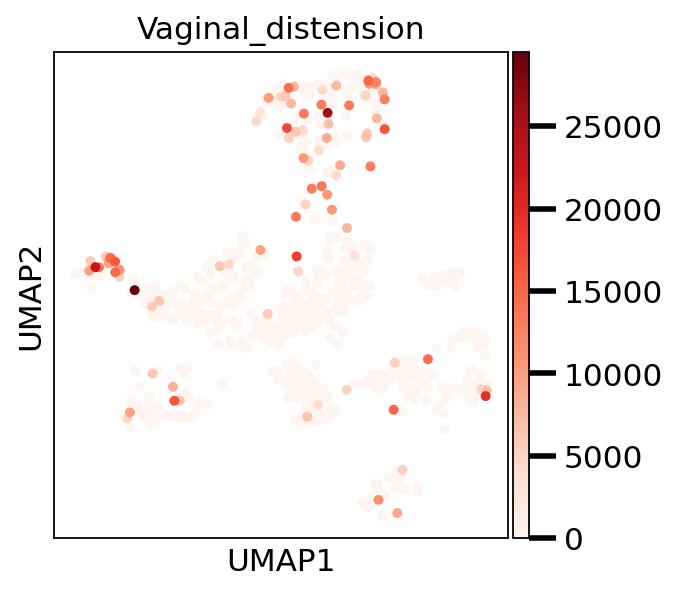

(682, 16000)


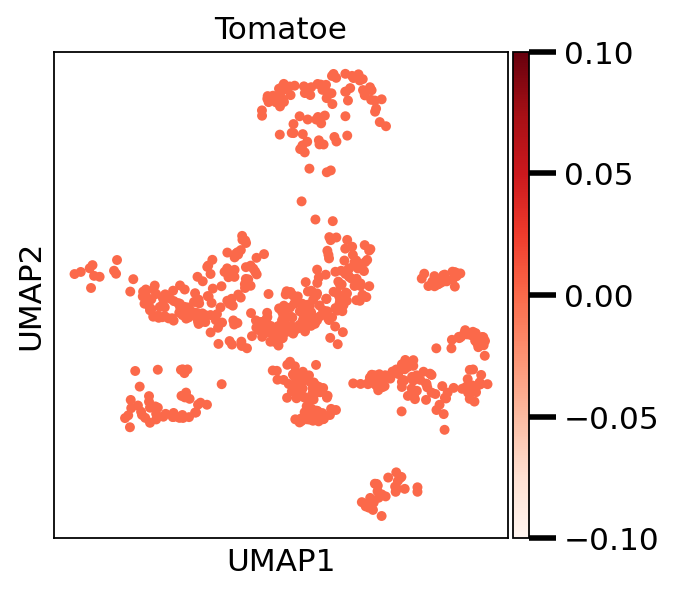

(662, 16000)


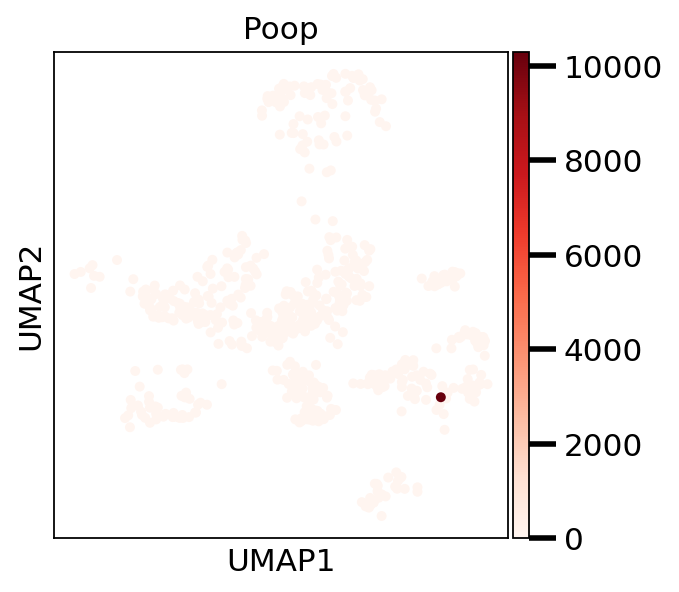

(670, 16000)


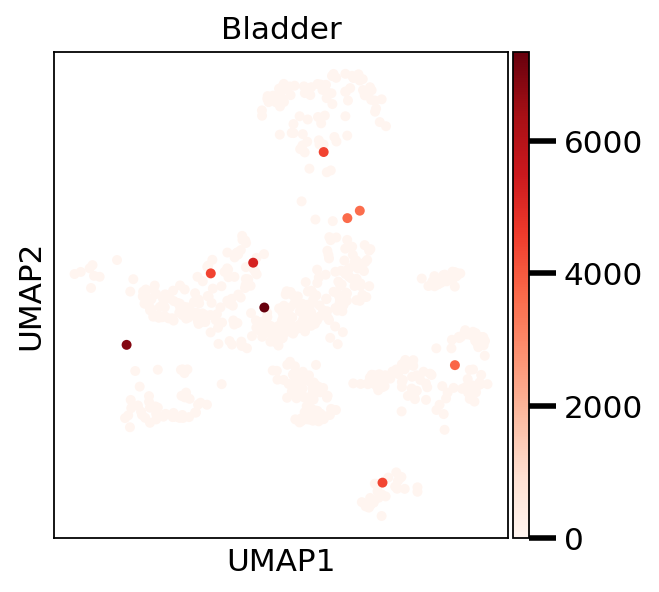

(664, 16000)


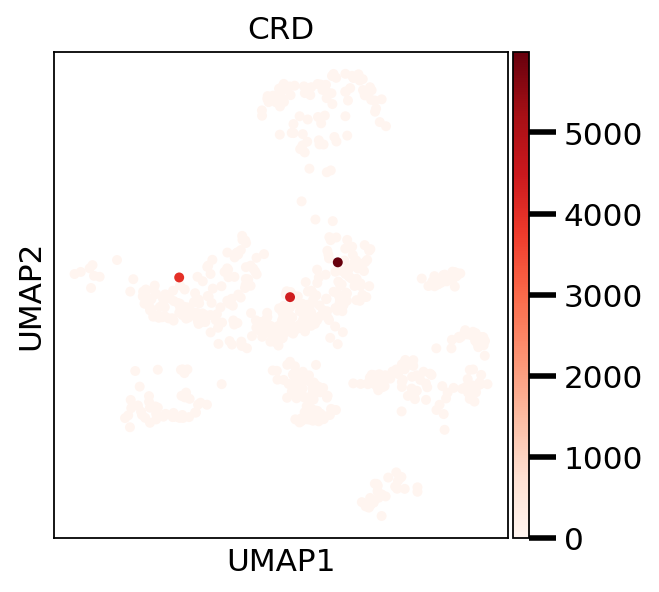

(756, 16000)


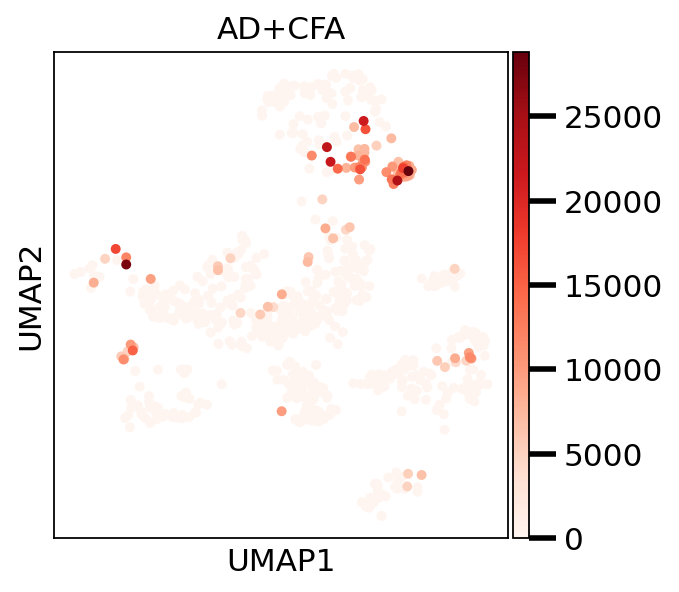

(779, 16000)


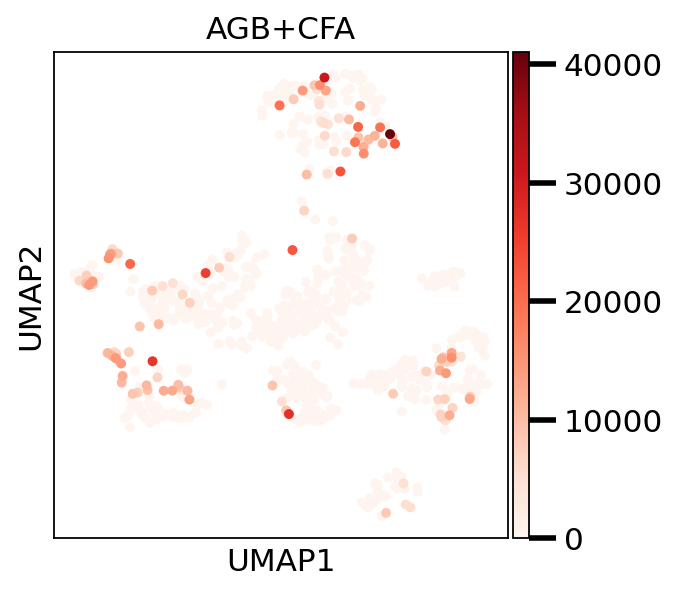

(744, 16000)


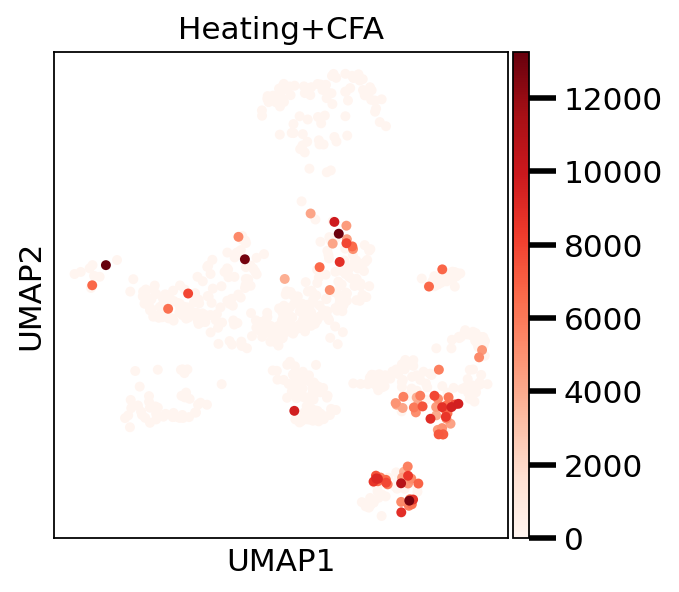

(709, 16000)


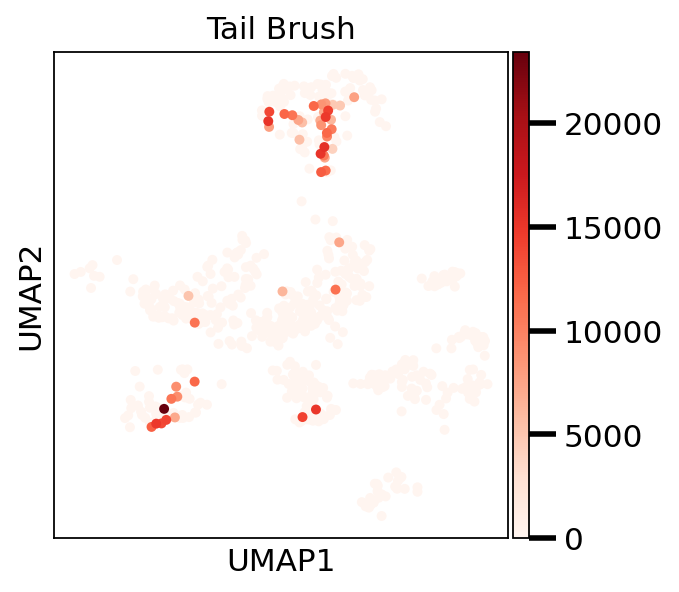

(741, 16000)


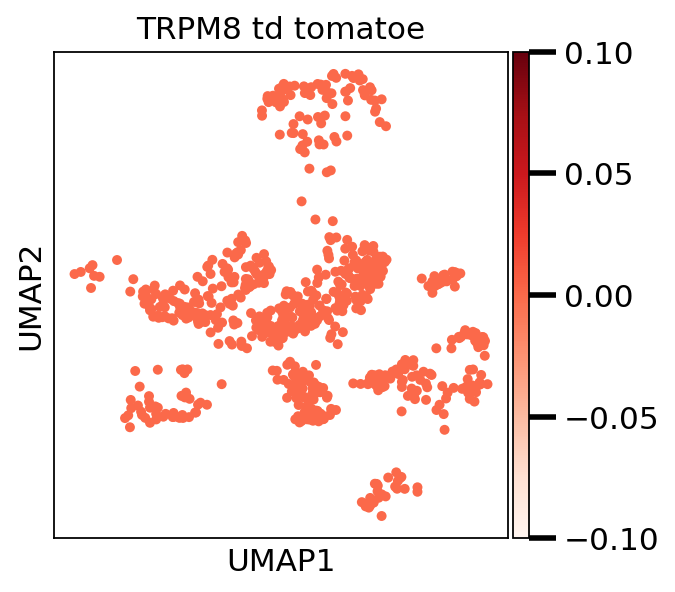

(713, 16000)


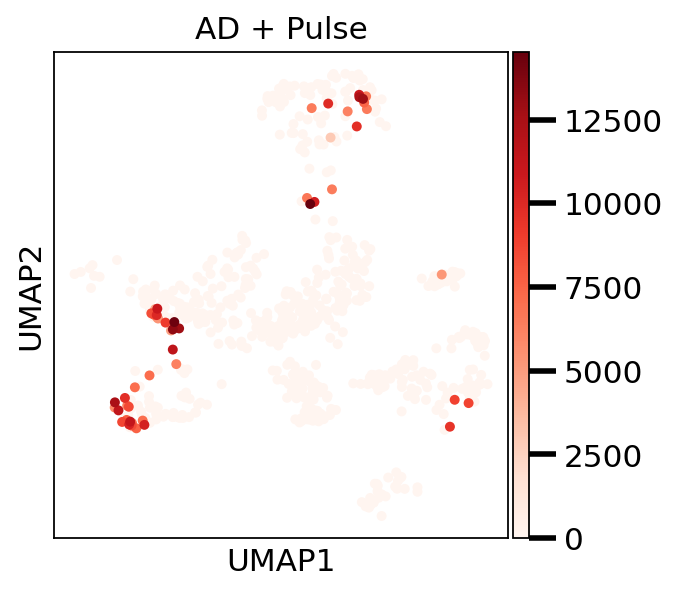

(705, 16000)


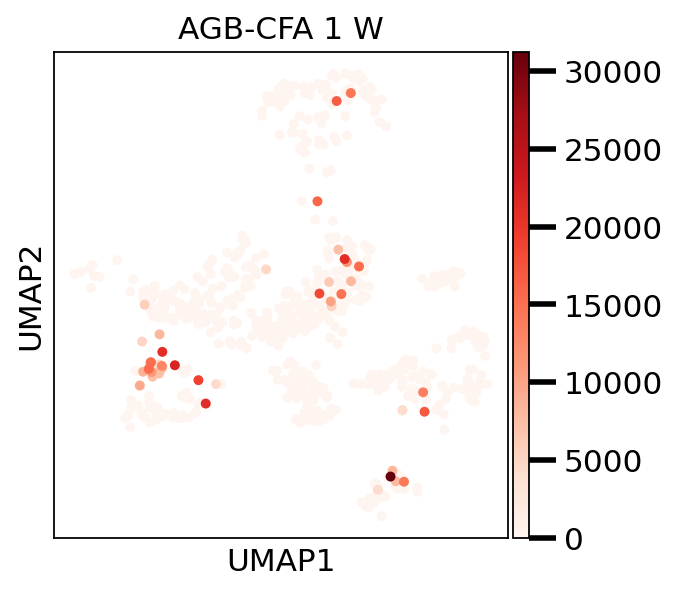

(703, 16000)


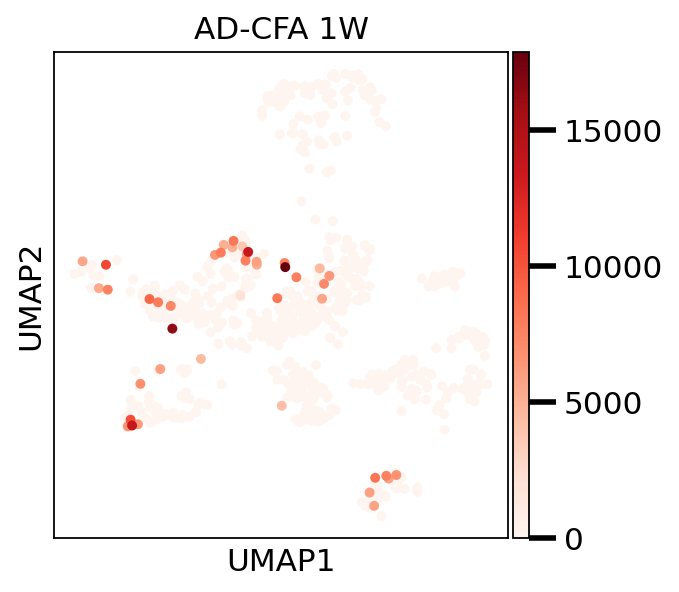

(775, 16000)


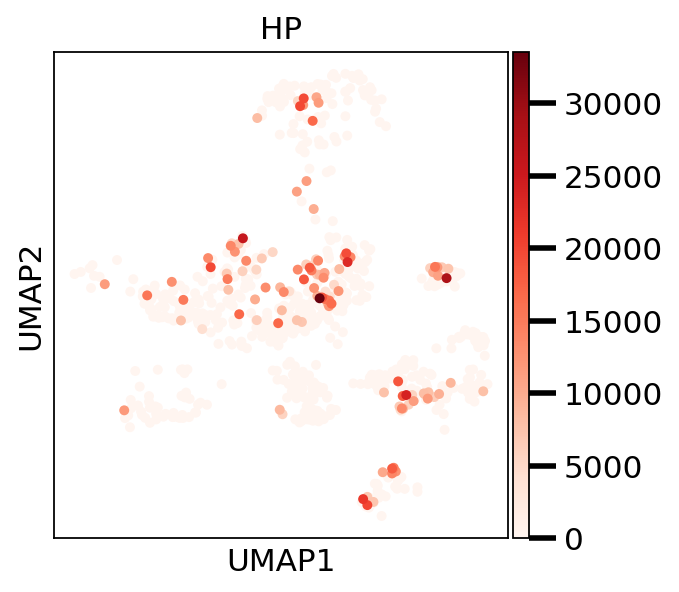

(748, 16000)


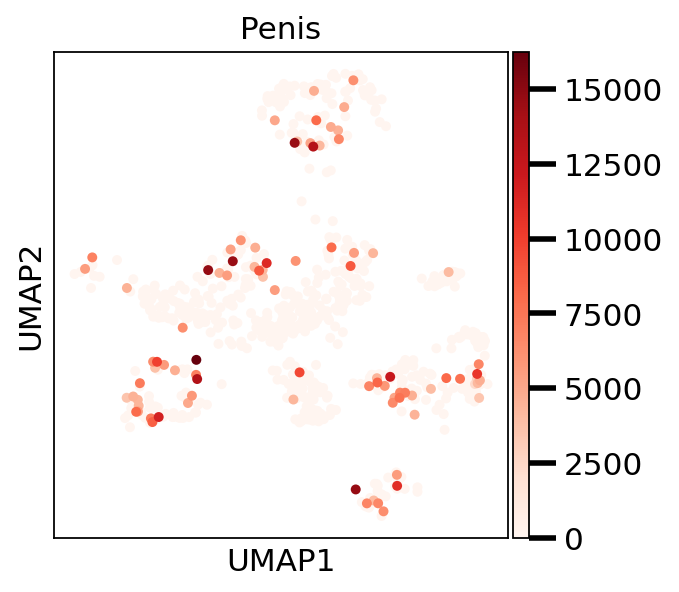

(711, 16000)


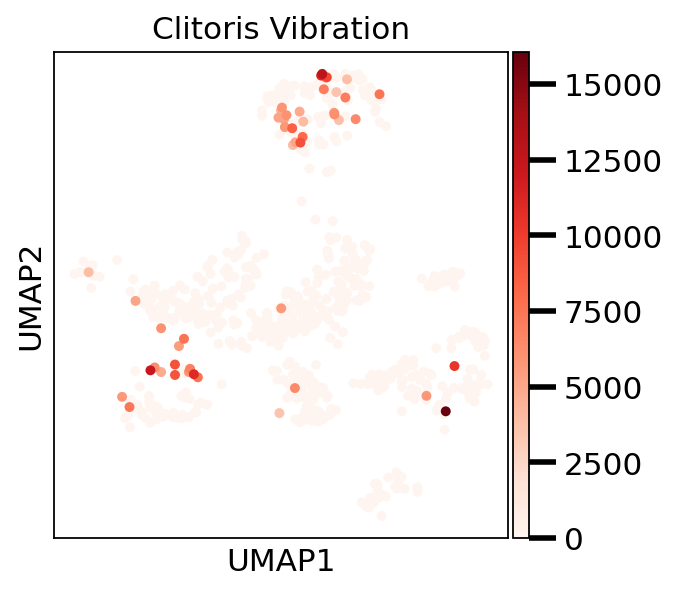

(677, 16000)


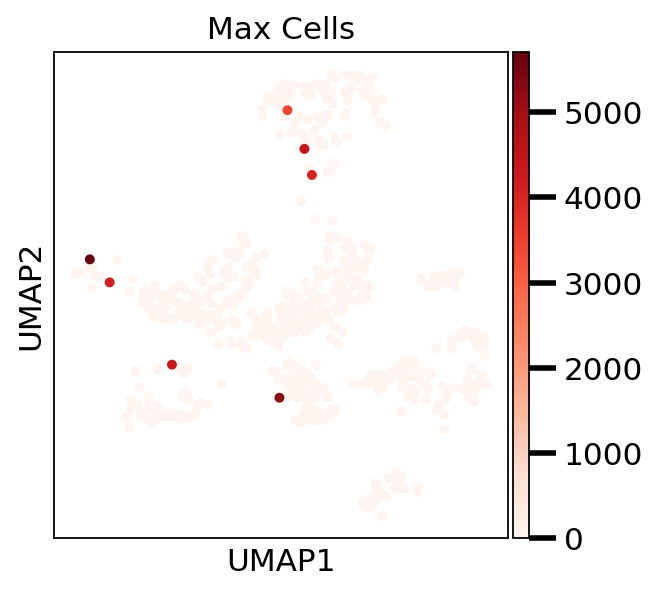

(701, 16000)


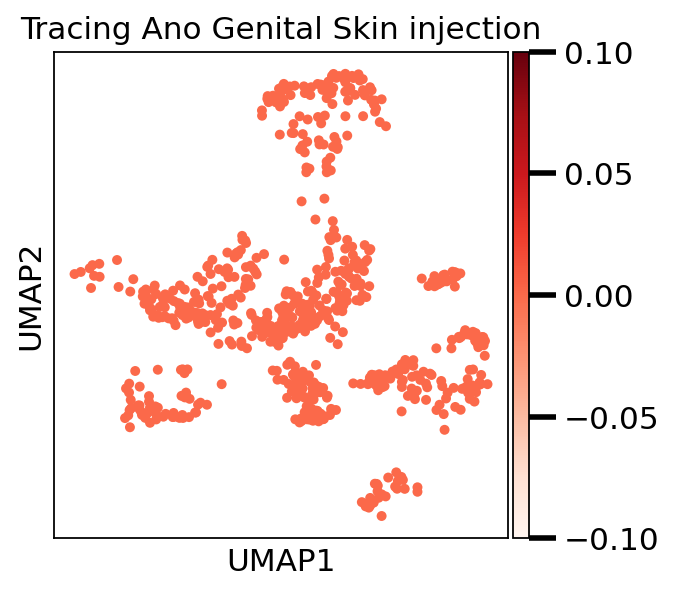

(673, 16000)


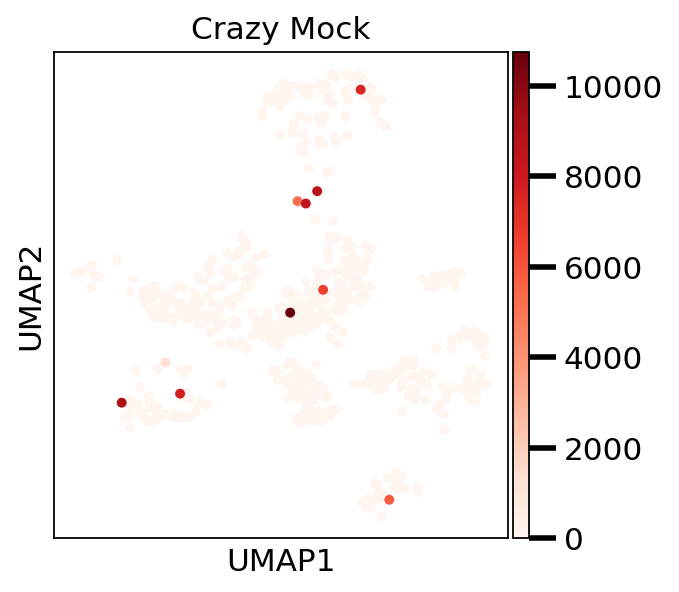

(709, 16000)


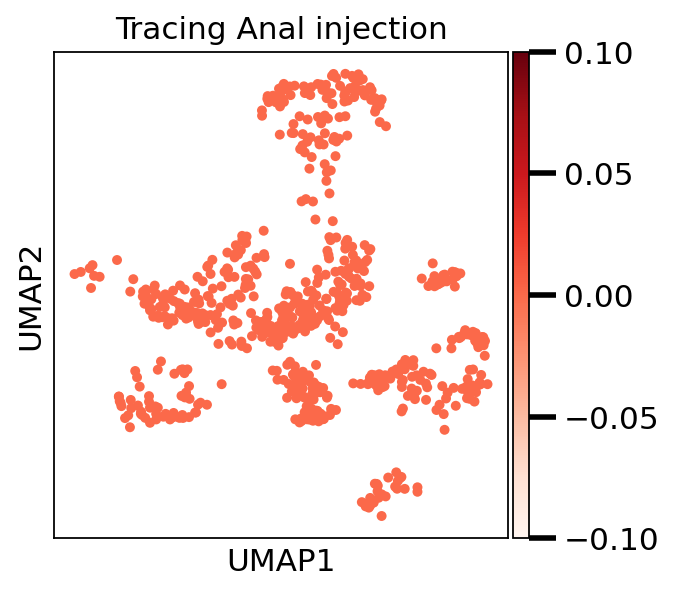

(673, 16000)


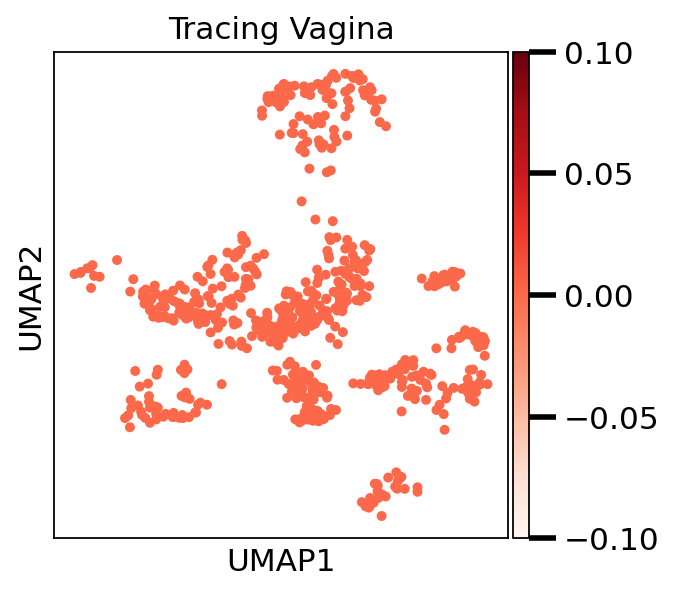

In [25]:
### plotting fluorecence levels stimulus by stimulus
for i in range(1,len(labels)):
    index = np.logical_or(adata_umap.obs['stimulus'] == i,adata_umap.obs['stimulus'] == 0)
    aux_adata = adata_umap[index,:]
    print(aux_adata.shape)
    sc.pl.umap(aux_adata, color = 'red', title=labels[i], color_map = 'Reds', save = '_fluorecence_stimulus_red_' + labels[i]+ '.png', size = 80)

In [26]:
# check how many of cells each stimulus has
for i,label in enumerate(labels):
    single_stim_data = adata_umap[adata_umap.obs['stimulus'] == i]
    total_cells = len(single_stim_data.obs['stimulus'].values)
    print(f"{label}: {total_cells} cells")

Control: 661 cells
Pinch: 146 cells
New_stroke: 118 cells
Ballon: 7 cells
AG: 141 cells
AD: 97 cells
Heating: 90 cells
Mock: 14 cells
Old_stroke: 52 cells
Anal_pinch: 30 cells
Mock_w_poop: 4 cells
Vaginal_distension: 87 cells
Tomatoe: 21 cells
Poop: 1 cells
Bladder: 9 cells
CRD: 3 cells
AD+CFA: 95 cells
AGB+CFA: 118 cells
Heating+CFA: 83 cells
Tail Brush: 48 cells
TRPM8 td tomatoe: 80 cells
AD + Pulse: 52 cells
AGB-CFA 1 W: 44 cells
AD-CFA 1W: 42 cells
HP: 114 cells
Penis: 87 cells
Clitoris Vibration: 50 cells
Max Cells: 16 cells
Tracing Ano Genital Skin injection: 40 cells
Crazy Mock: 12 cells
Tracing Anal injection: 48 cells
Tracing Vagina: 12 cells
